In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.naive_bayes import GaussianNB
from sklearn.neural_network import MLPClassifier
from sklearn.tree import DecisionTreeClassifier

from utils import evaluate_and_augment_test, plot_prediction

%load_ext autoreload
%autoreload 2

# Creating Yin Yang dataset

In [2]:
def boundary_curve(x, scalar):
    return scalar*x*(3/4 - x**2)

In [3]:
n = 100000
boundary_scaler = -1
small_circle_radius = 0.25
radius = np.random.uniform(0, 1, n)
angle = np.random.uniform(0, 2*np.pi, n)
x = radius*np.cos(angle)
y = radius*np.sin(angle)
s = boundary_curve(x, boundary_scaler)

# rotate
xx = x*np.cos(np.pi/2) + y*np.sin(np.pi/2)
yy = -x*np.sin(np.pi/2) + y*np.cos(np.pi/2)
xs = x*np.cos(np.pi/2) + s*np.sin(np.pi/2)
s = -x*np.sin(np.pi/2) + s*np.cos(np.pi/2)
x, y = xx, yy

left_condition = (x < xs) & ((x + 0.5)**2 + y**2 > small_circle_radius**2)
right_condition = (x > xs) & ((x - 0.5)**2 + y**2 < small_circle_radius**2)
target = (left_condition | right_condition)

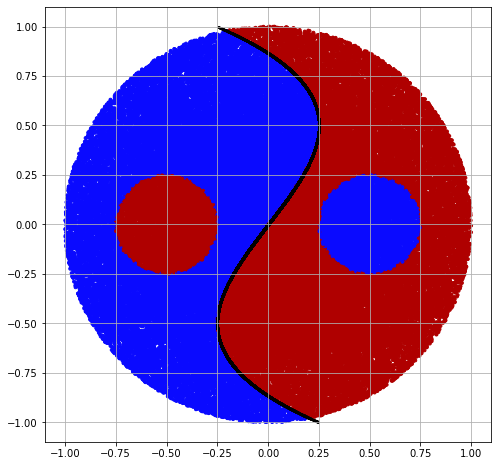

In [4]:
fig, ax = plt.subplots(1, 1, figsize=(8, 8))
color = np.array(list(map({True: "#0A0AFF", False: "#AF0000"}.get, target)))
plt.scatter(x, y, color=color, s=9)
plt.scatter(xs, s, color='black', s=1)
ax.grid()

In [5]:
df = pd.DataFrame({"x": x, "y": y, "target": target.astype(int)})

# Using $x$, $y$ as inputs

In [6]:
X_train, X_test, y_train, y_test = train_test_split(
    df[["x", "y"]], df["target"],
    test_size=0.25, shuffle=False
)

              precision    recall  f1-score   support

           0       0.81      0.80      0.80     12523
           1       0.80      0.81      0.80     12477

    accuracy                           0.80     25000
   macro avg       0.80      0.80      0.80     25000
weighted avg       0.80      0.80      0.80     25000



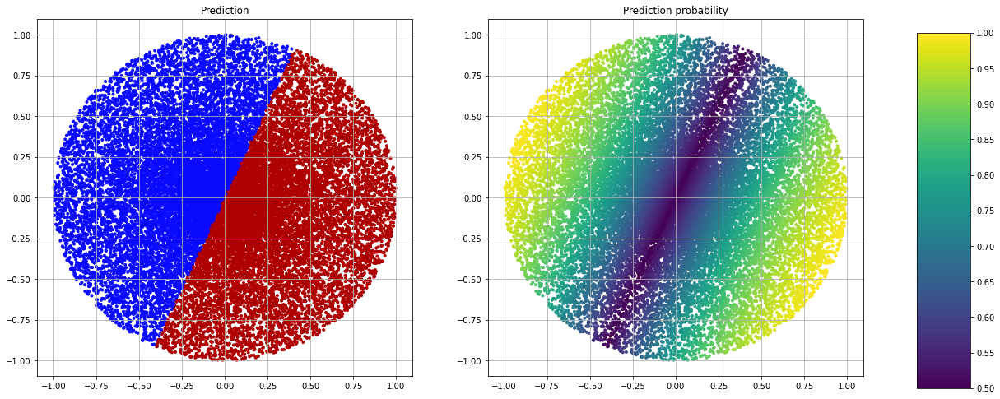

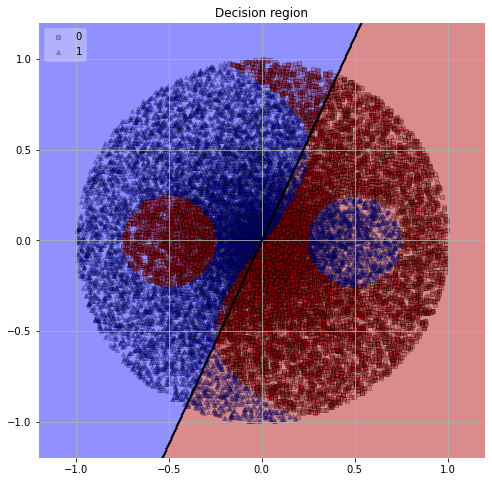

In [7]:
lr_clf = LogisticRegression(random_state=0)
lr_clf.fit(X_train, y_train)

X_test_augmented = evaluate_and_augment_test(X_test, y_test, lr_clf)
plot_prediction(X_test_augmented, y_test, lr_clf)

              precision    recall  f1-score   support

           0       1.00      0.99      0.99     12523
           1       0.99      1.00      0.99     12477

    accuracy                           0.99     25000
   macro avg       0.99      0.99      0.99     25000
weighted avg       0.99      0.99      0.99     25000



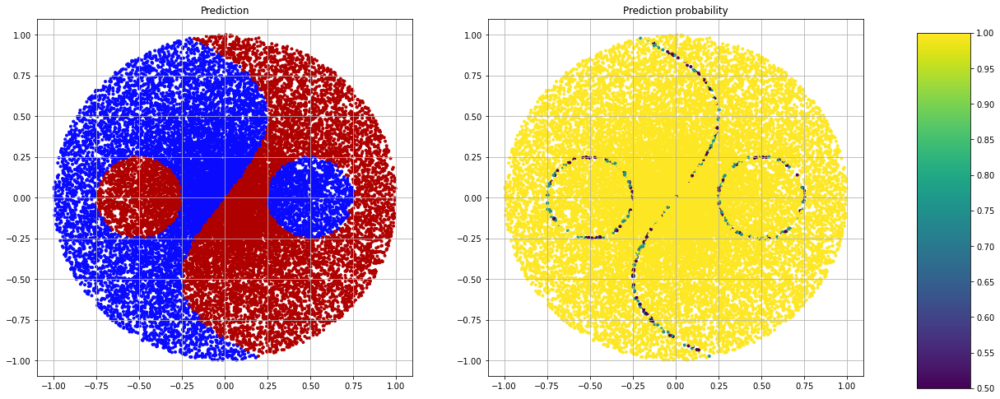

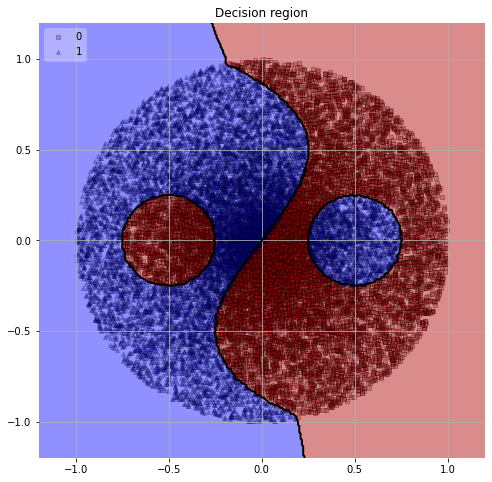

In [8]:
knn_clf = KNeighborsClassifier()
knn_clf.fit(X_train, y_train)

X_test_augmented = evaluate_and_augment_test(X_test, y_test, knn_clf)
plot_prediction(X_test_augmented, y_test, knn_clf)

===================================  linear  ===================================


/Users/ajaypethani/anaconda3/lib/python3.7/site-packages/sklearn/svm/_base.py:258: ConvergenceWarning: Solver terminated early (max_iter=750).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


              precision    recall  f1-score   support

           0       0.78      0.63      0.70     12523
           1       0.69      0.82      0.75     12477

    accuracy                           0.73     25000
   macro avg       0.74      0.73      0.72     25000
weighted avg       0.74      0.73      0.72     25000



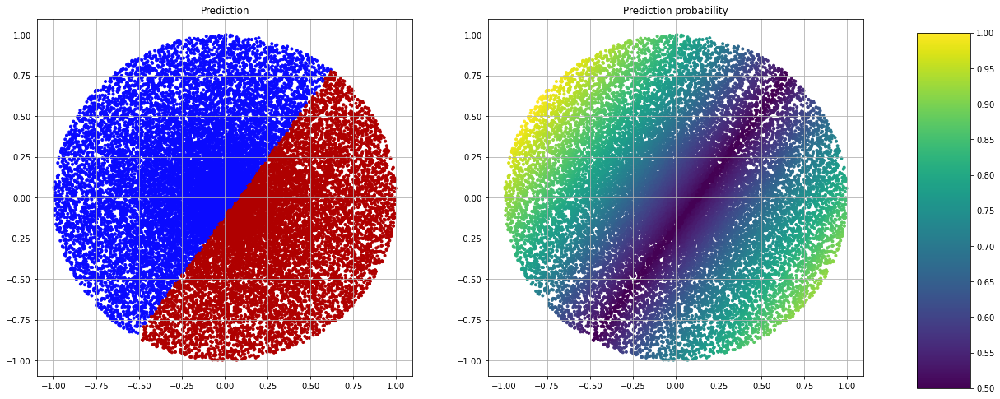

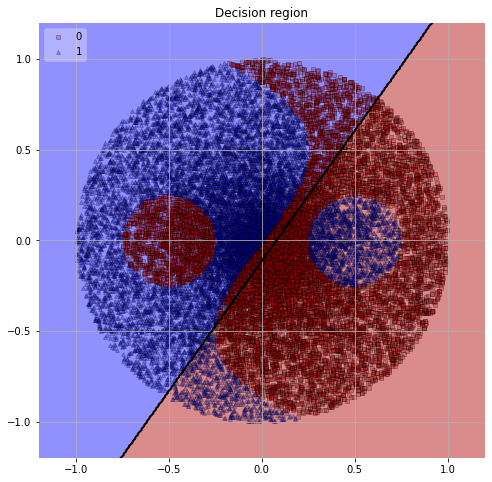

===================================  poly  ===================================


/Users/ajaypethani/anaconda3/lib/python3.7/site-packages/sklearn/svm/_base.py:258: ConvergenceWarning: Solver terminated early (max_iter=750).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


              precision    recall  f1-score   support

           0       0.95      0.21      0.35     12523
           1       0.56      0.99      0.71     12477

    accuracy                           0.60     25000
   macro avg       0.75      0.60      0.53     25000
weighted avg       0.75      0.60      0.53     25000



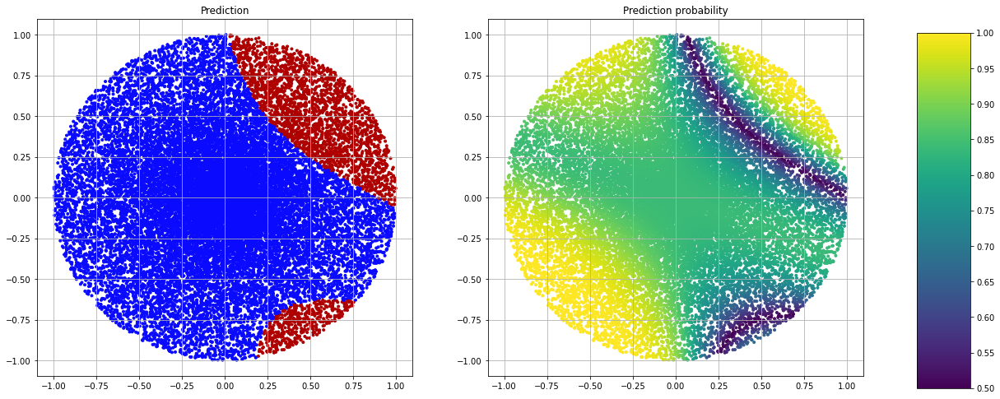

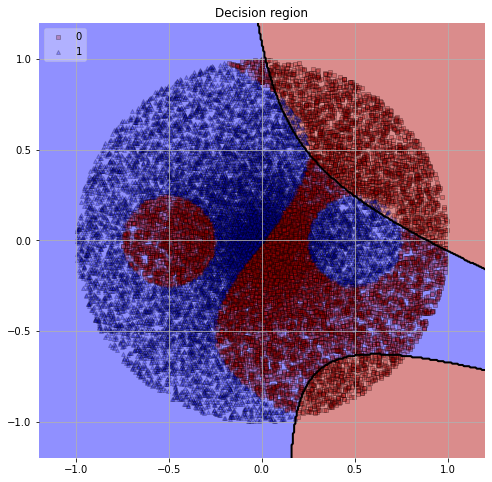

===================================  rbf  ===================================


/Users/ajaypethani/anaconda3/lib/python3.7/site-packages/sklearn/svm/_base.py:258: ConvergenceWarning: Solver terminated early (max_iter=750).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


              precision    recall  f1-score   support

           0       0.67      0.52      0.59     12523
           1       0.61      0.74      0.67     12477

    accuracy                           0.63     25000
   macro avg       0.64      0.63      0.63     25000
weighted avg       0.64      0.63      0.63     25000



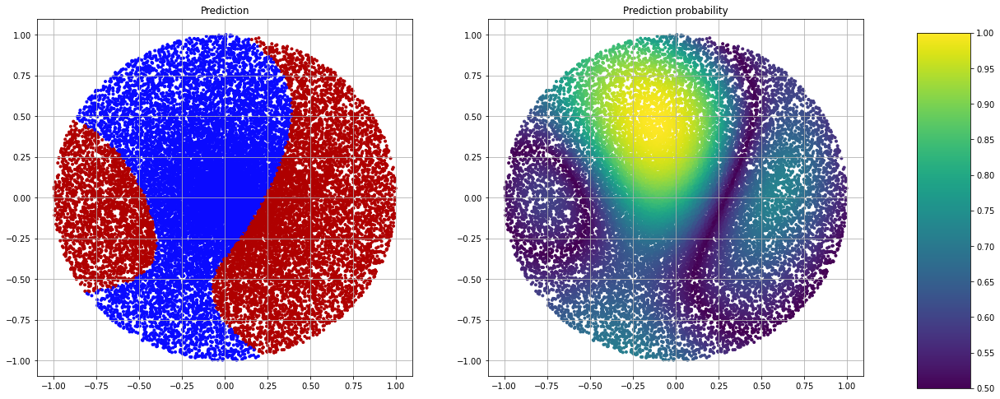

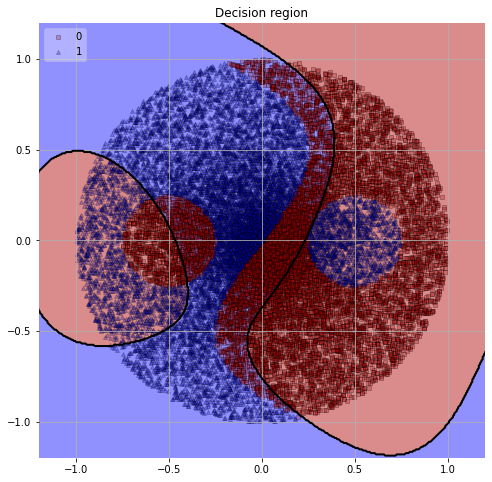

===================================  sigmoid  ===================================


/Users/ajaypethani/anaconda3/lib/python3.7/site-packages/sklearn/svm/_base.py:258: ConvergenceWarning: Solver terminated early (max_iter=750).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


              precision    recall  f1-score   support

           0       0.44      0.32      0.37     12523
           1       0.46      0.59      0.52     12477

    accuracy                           0.45     25000
   macro avg       0.45      0.45      0.44     25000
weighted avg       0.45      0.45      0.44     25000



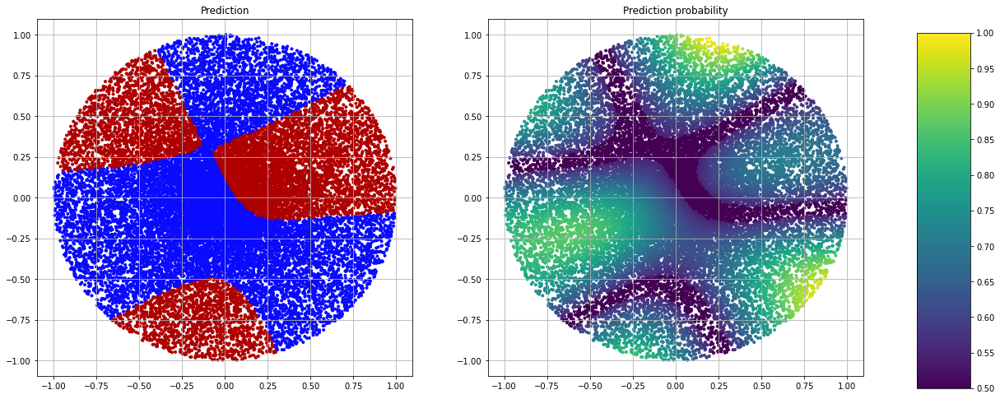

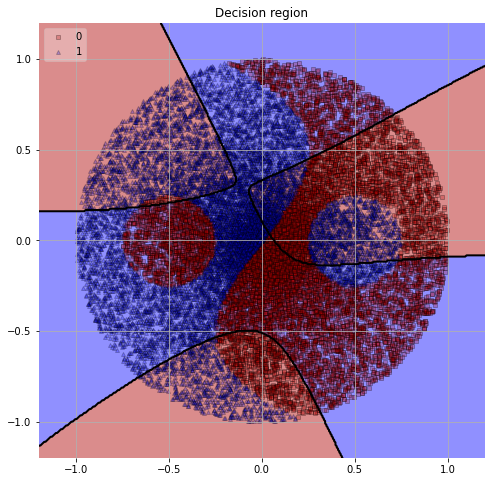

In [9]:
for kernel in ["linear", "poly", "rbf", "sigmoid"]:
    print("="*35, f" {kernel} ", "="*35)
    svc_clf = SVC(kernel=kernel, max_iter=750, random_state=0, probability=True)
    svc_clf.fit(X_train, y_train)

    X_test_augmented = evaluate_and_augment_test(X_test, y_test, svc_clf)
    plot_prediction(X_test_augmented, y_test, svc_clf)

              precision    recall  f1-score   support

           0       0.80      0.80      0.80     12523
           1       0.80      0.79      0.80     12477

    accuracy                           0.80     25000
   macro avg       0.80      0.80      0.80     25000
weighted avg       0.80      0.80      0.80     25000



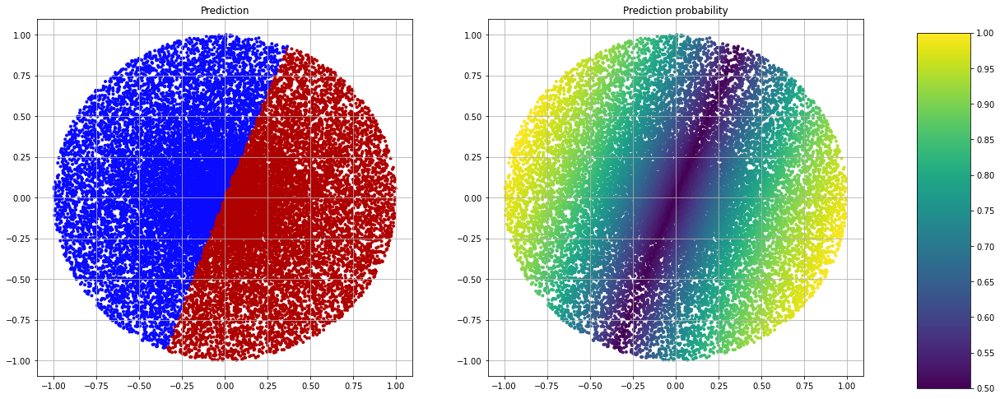

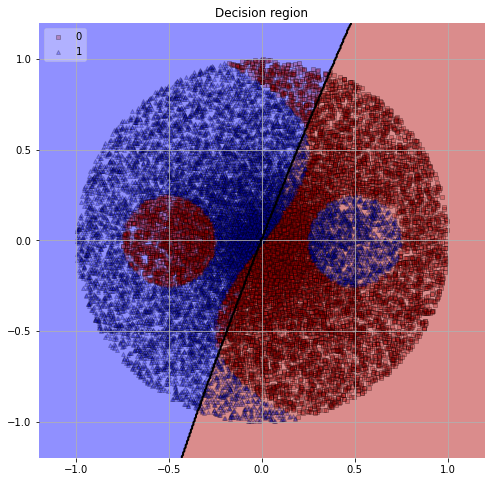

In [10]:
gnb_clf = GaussianNB()
gnb_clf.fit(X_train, y_train)

X_test_augmented = evaluate_and_augment_test(X_test, y_test, gnb_clf)
plot_prediction(X_test_augmented, y_test, gnb_clf)

/Users/ajaypethani/anaconda3/lib/python3.7/site-packages/sklearn/neural_network/_multilayer_perceptron.py:617: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


              precision    recall  f1-score   support

           0       0.99      1.00      0.99     12523
           1       1.00      0.99      0.99     12477

    accuracy                           0.99     25000
   macro avg       0.99      0.99      0.99     25000
weighted avg       0.99      0.99      0.99     25000



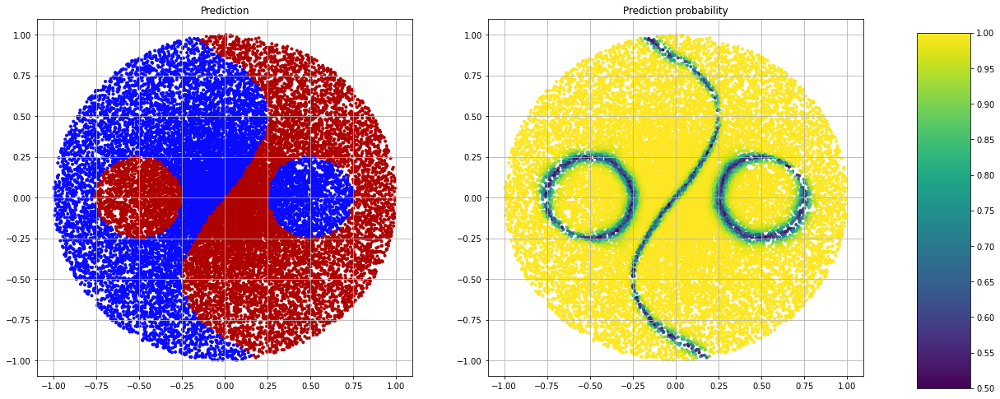

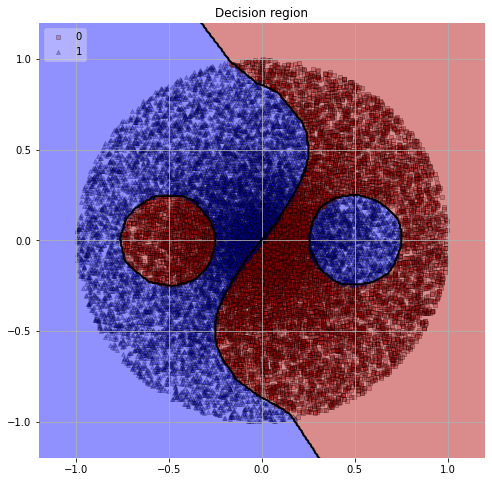

In [11]:
mlp_clf = MLPClassifier(batch_size=1000, random_state=0, max_iter=300)
mlp_clf.fit(X_train, y_train)

X_test_augmented = evaluate_and_augment_test(X_test, y_test, mlp_clf)
plot_prediction(X_test_augmented, y_test, mlp_clf)

/Users/ajaypethani/anaconda3/lib/python3.7/site-packages/sklearn/neural_network/_multilayer_perceptron.py:617: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


              precision    recall  f1-score   support

           0       0.97      0.98      0.98     12523
           1       0.98      0.97      0.98     12477

    accuracy                           0.98     25000
   macro avg       0.98      0.98      0.98     25000
weighted avg       0.98      0.98      0.98     25000



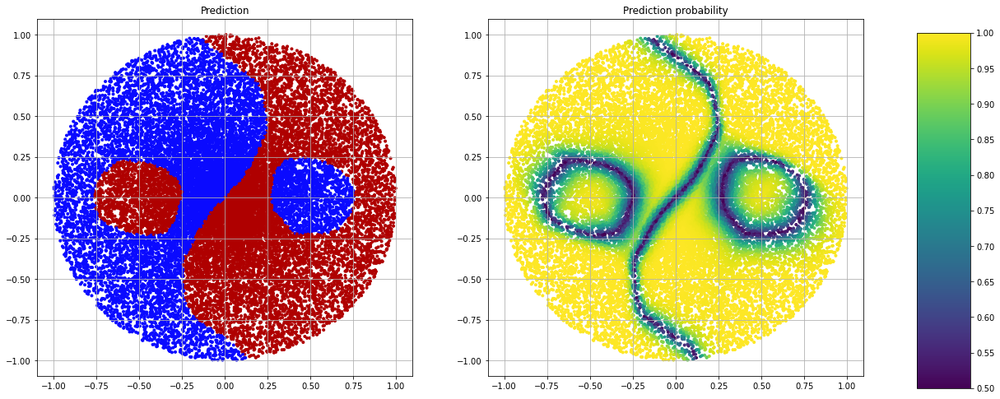

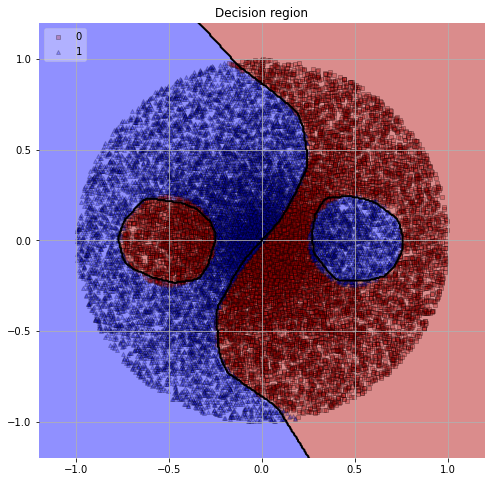

In [12]:
mlp_clf = MLPClassifier(batch_size=5000, random_state=0, max_iter=300)
mlp_clf.fit(X_train, y_train)

X_test_augmented = evaluate_and_augment_test(X_test, y_test, mlp_clf)
plot_prediction(X_test_augmented, y_test, mlp_clf)

/Users/ajaypethani/anaconda3/lib/python3.7/site-packages/sklearn/neural_network/_multilayer_perceptron.py:617: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


              precision    recall  f1-score   support

           0       0.92      0.93      0.92     12523
           1       0.93      0.92      0.92     12477

    accuracy                           0.92     25000
   macro avg       0.92      0.92      0.92     25000
weighted avg       0.92      0.92      0.92     25000



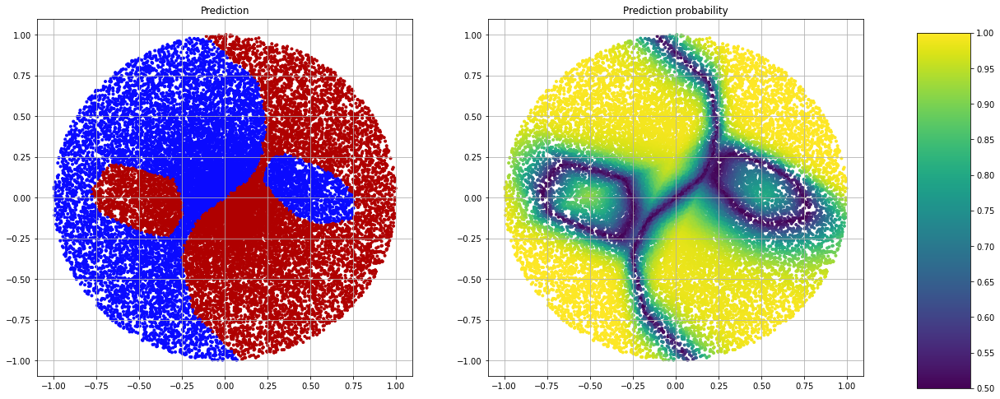

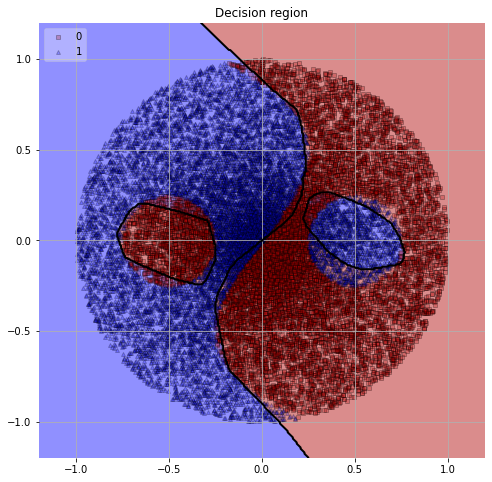

In [13]:
mlp_clf = MLPClassifier(batch_size=10000, random_state=0, max_iter=300)
mlp_clf.fit(X_train, y_train)

X_test_augmented = evaluate_and_augment_test(X_test, y_test, mlp_clf)
plot_prediction(X_test_augmented, y_test, mlp_clf)

===================================  max_depth=5  ===================================
              precision    recall  f1-score   support

           0       0.81      0.63      0.71     12523
           1       0.70      0.85      0.77     12477

    accuracy                           0.74     25000
   macro avg       0.75      0.74      0.74     25000
weighted avg       0.75      0.74      0.74     25000



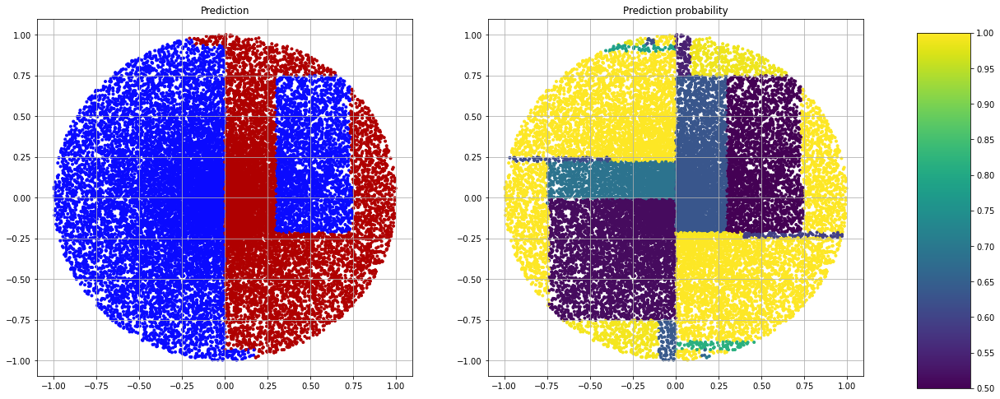

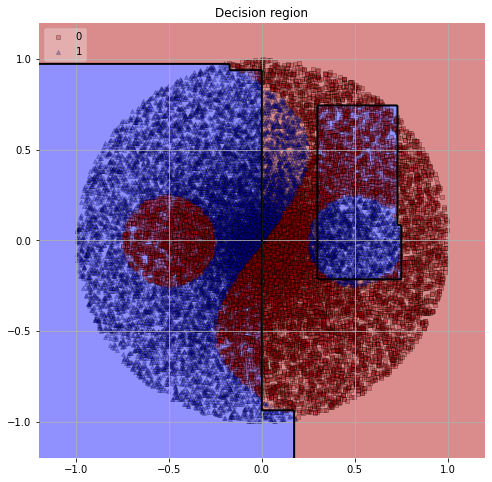

===================================  max_depth=10  ===================================
              precision    recall  f1-score   support

           0       0.97      0.98      0.98     12523
           1       0.98      0.97      0.98     12477

    accuracy                           0.98     25000
   macro avg       0.98      0.98      0.98     25000
weighted avg       0.98      0.98      0.98     25000



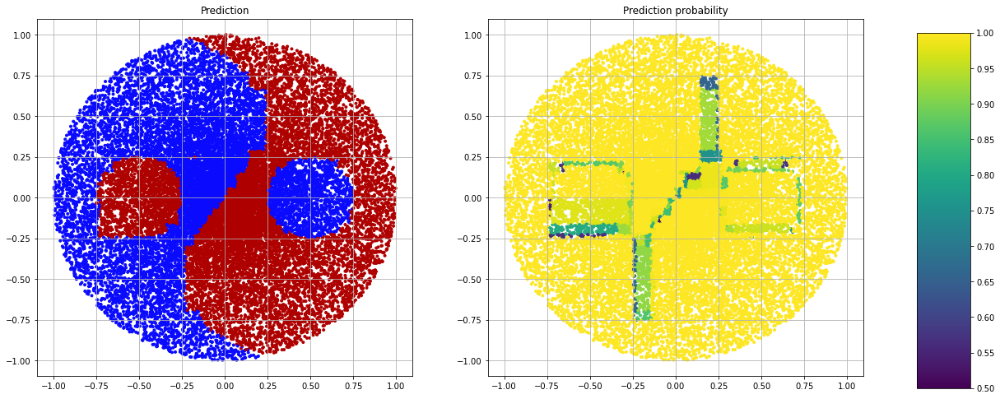

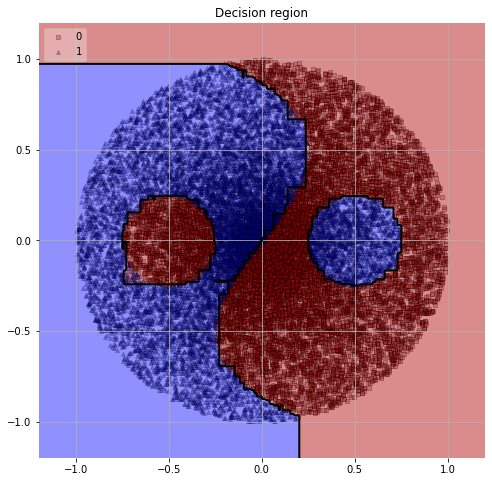

===================================  max_depth=15  ===================================
              precision    recall  f1-score   support

           0       0.99      0.99      0.99     12523
           1       0.99      0.99      0.99     12477

    accuracy                           0.99     25000
   macro avg       0.99      0.99      0.99     25000
weighted avg       0.99      0.99      0.99     25000



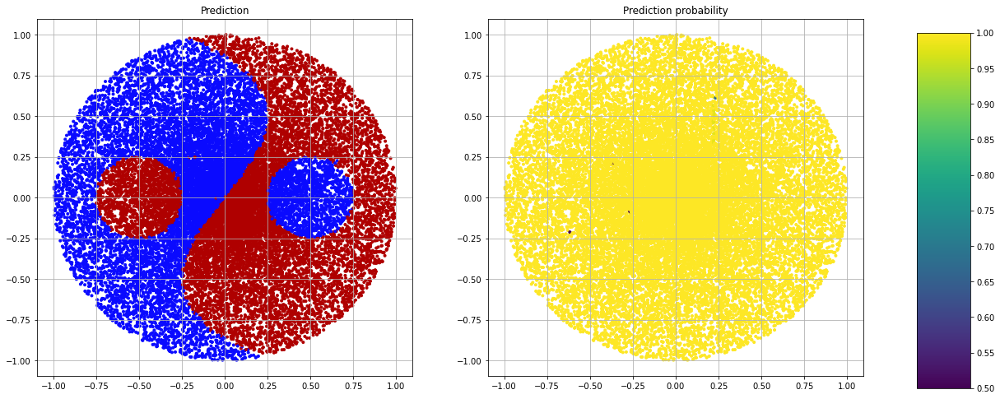

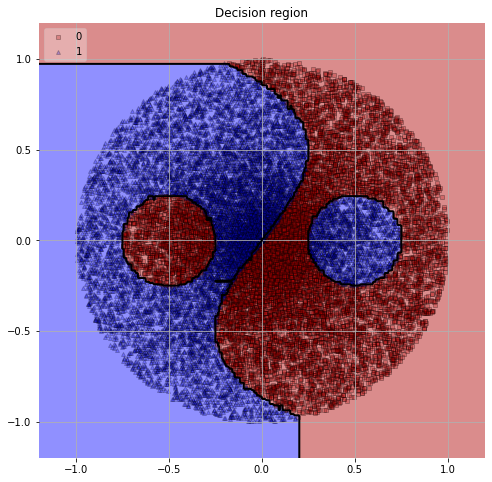

In [14]:
for max_depth in [5, 10, 15]:
    print("="*35, f" max_depth={max_depth} ", "="*35)
    dt_clf = DecisionTreeClassifier(max_depth=max_depth)
    dt_clf.fit(X_train, y_train)

    X_test_augmented = evaluate_and_augment_test(X_test, y_test, dt_clf)
    plot_prediction(X_test_augmented, y_test, dt_clf)

# Using $(x + y)/2$, $(x - y)/2$ as inputs

In [15]:
df2 = pd.DataFrame({"feat1": (df.x + df.y)/2, "feat2": (df.x - df.y)/2, "target": df.target})

In [16]:
X_train, X_test, y_train, y_test = train_test_split(
    df2[["feat1", "feat2"]], df2["target"],
    test_size=0.25, shuffle=False
)

===================================  max_depth=5  ===================================
              precision    recall  f1-score   support

           0       0.89      0.90      0.90     12523
           1       0.90      0.89      0.89     12477

    accuracy                           0.89     25000
   macro avg       0.89      0.89      0.89     25000
weighted avg       0.89      0.89      0.89     25000



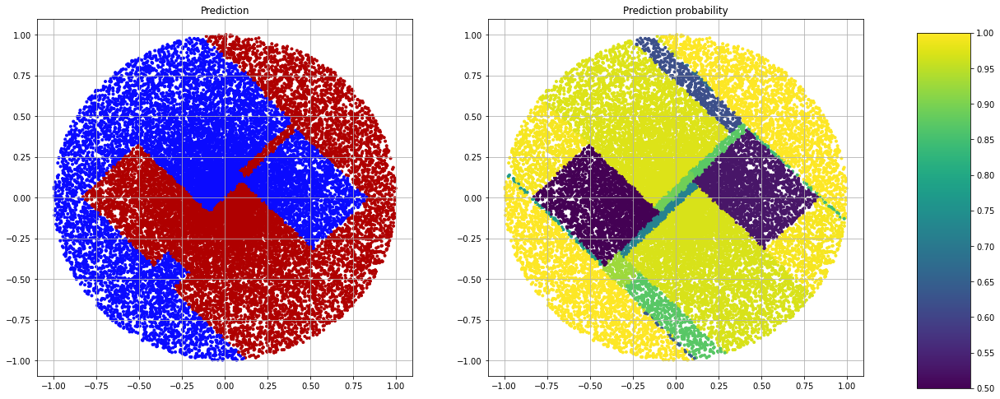

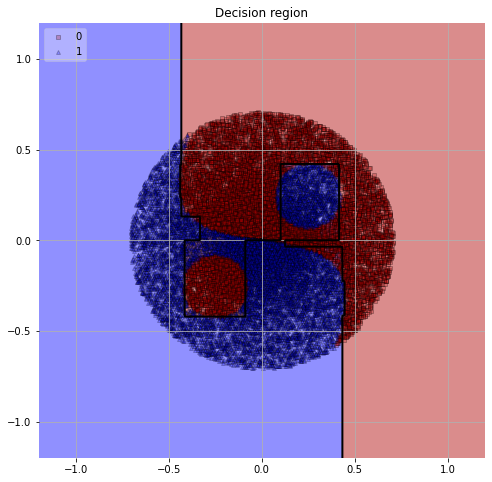

===================================  max_depth=10  ===================================
              precision    recall  f1-score   support

           0       0.99      0.99      0.99     12523
           1       0.99      0.99      0.99     12477

    accuracy                           0.99     25000
   macro avg       0.99      0.99      0.99     25000
weighted avg       0.99      0.99      0.99     25000



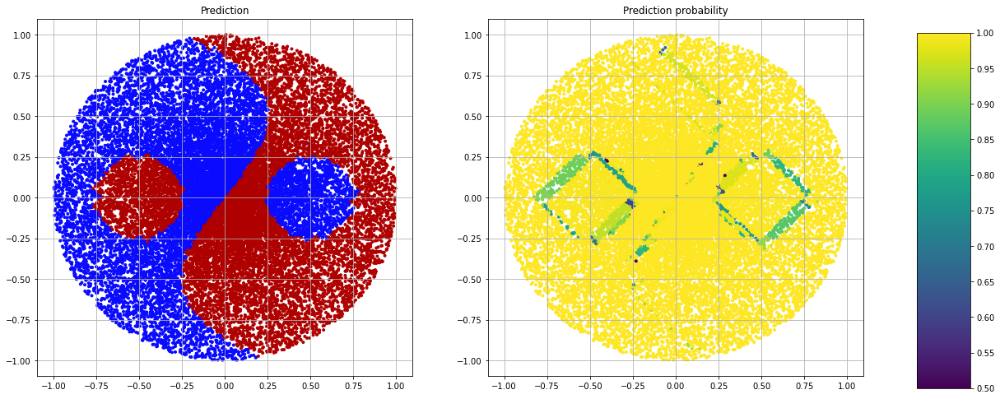

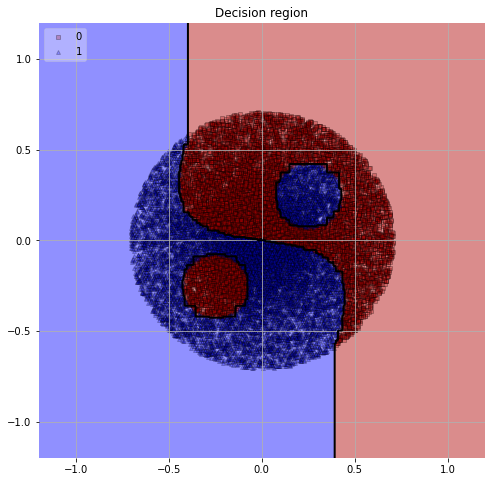

===================================  max_depth=15  ===================================
              precision    recall  f1-score   support

           0       1.00      0.99      0.99     12523
           1       0.99      1.00      0.99     12477

    accuracy                           0.99     25000
   macro avg       0.99      0.99      0.99     25000
weighted avg       0.99      0.99      0.99     25000



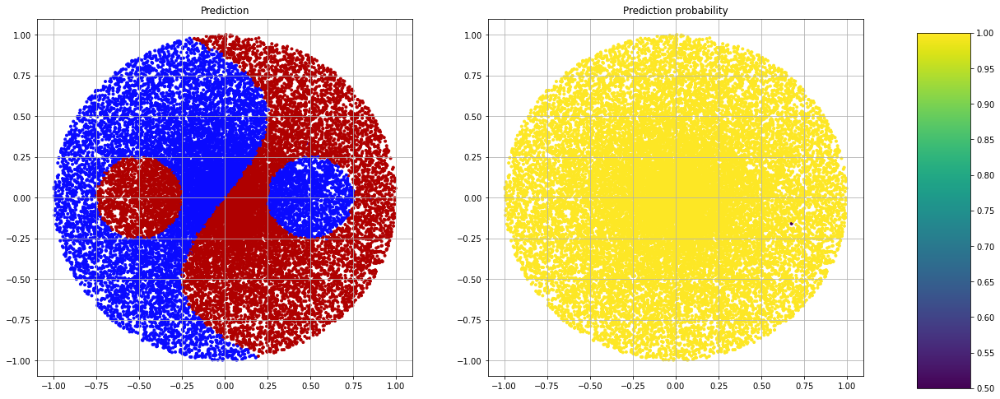

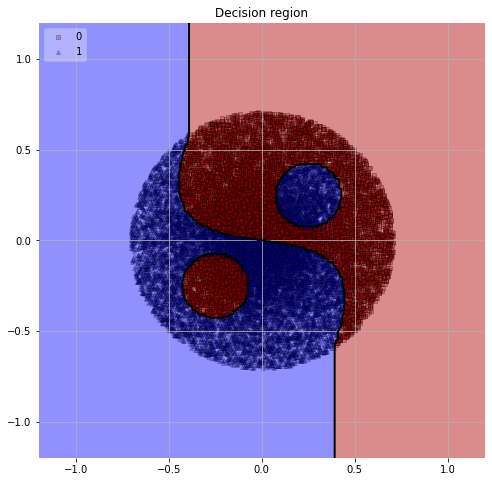

In [17]:
for max_depth in [5, 10, 15]:
    print("="*35, f" max_depth={max_depth} ", "="*35)
    dt_clf = DecisionTreeClassifier(max_depth=max_depth)
    dt_clf.fit(X_train, y_train)

    X_test_augmented = evaluate_and_augment_test(X_test, y_test, dt_clf)
    X_test_augmented['x'] = df.loc[X_test_augmented.index]["x"].copy()
    X_test_augmented['y'] = df.loc[X_test_augmented.index]["y"].copy()
    plot_prediction(X_test_augmented, y_test, dt_clf)

===================================  linear  ===================================


/Users/ajaypethani/anaconda3/lib/python3.7/site-packages/sklearn/svm/_base.py:258: ConvergenceWarning: Solver terminated early (max_iter=750).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


              precision    recall  f1-score   support

           0       0.78      0.64      0.70     12523
           1       0.69      0.82      0.75     12477

    accuracy                           0.73     25000
   macro avg       0.74      0.73      0.73     25000
weighted avg       0.74      0.73      0.73     25000



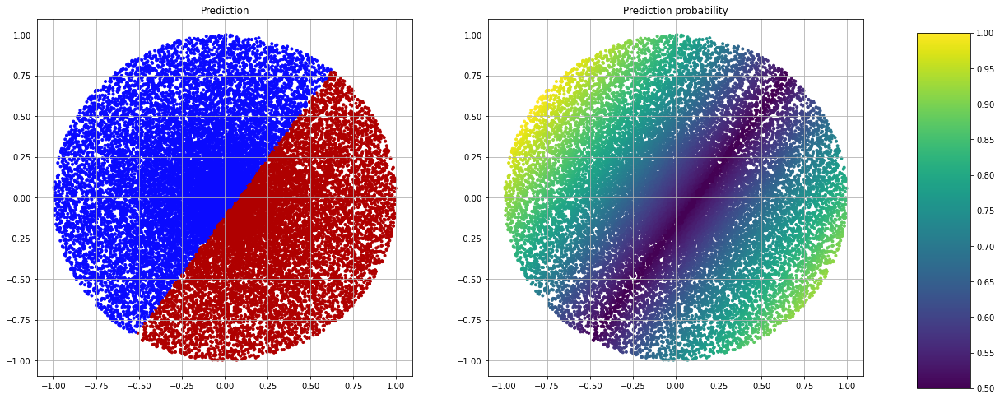

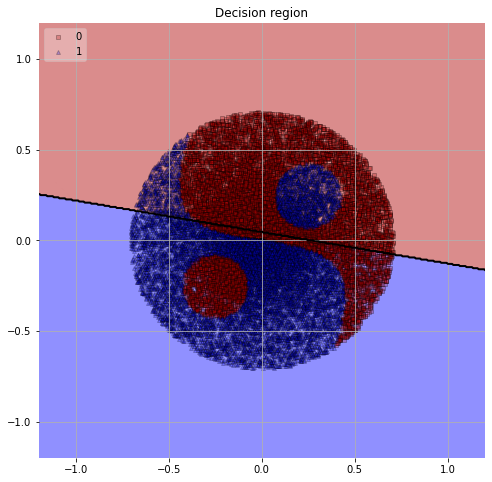

===================================  poly  ===================================


/Users/ajaypethani/anaconda3/lib/python3.7/site-packages/sklearn/svm/_base.py:258: ConvergenceWarning: Solver terminated early (max_iter=750).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


              precision    recall  f1-score   support

           0       0.95      0.21      0.35     12523
           1       0.56      0.99      0.71     12477

    accuracy                           0.60     25000
   macro avg       0.75      0.60      0.53     25000
weighted avg       0.75      0.60      0.53     25000



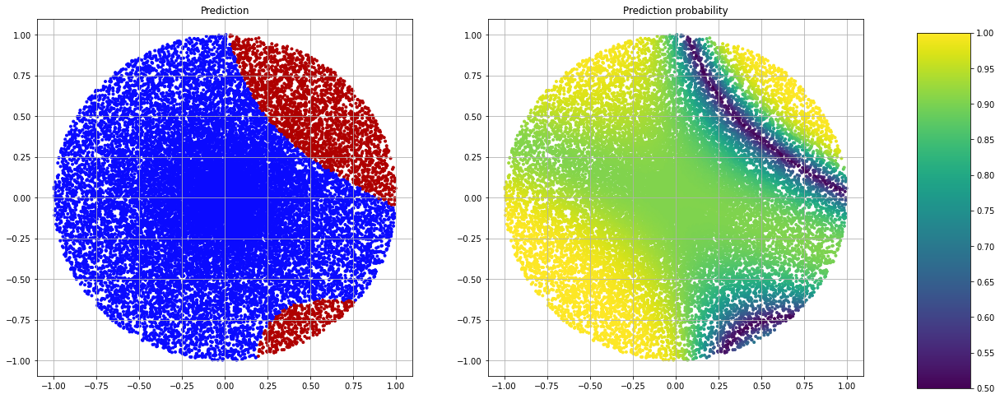

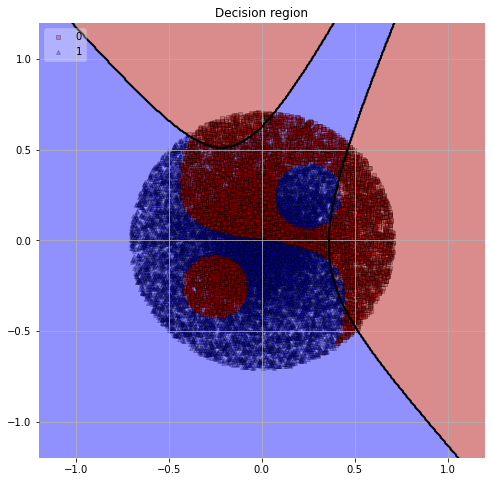

===================================  rbf  ===================================


/Users/ajaypethani/anaconda3/lib/python3.7/site-packages/sklearn/svm/_base.py:258: ConvergenceWarning: Solver terminated early (max_iter=750).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


              precision    recall  f1-score   support

           0       0.67      0.52      0.59     12523
           1       0.61      0.74      0.67     12477

    accuracy                           0.63     25000
   macro avg       0.64      0.63      0.63     25000
weighted avg       0.64      0.63      0.63     25000



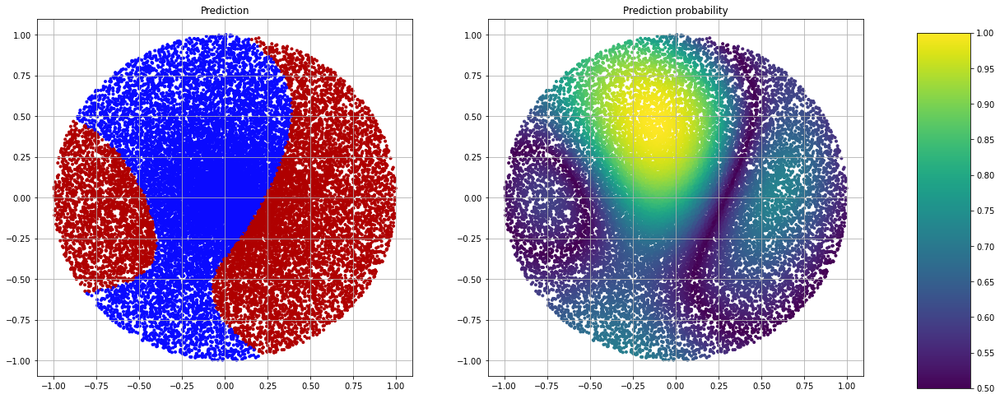

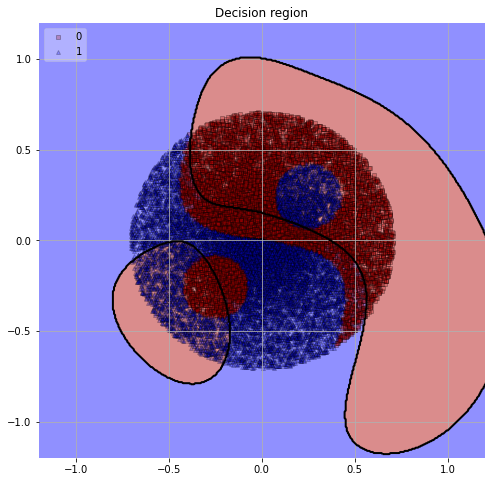

===================================  sigmoid  ===================================


/Users/ajaypethani/anaconda3/lib/python3.7/site-packages/sklearn/svm/_base.py:258: ConvergenceWarning: Solver terminated early (max_iter=750).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


              precision    recall  f1-score   support

           0       0.44      0.32      0.37     12523
           1       0.46      0.59      0.52     12477

    accuracy                           0.45     25000
   macro avg       0.45      0.45      0.44     25000
weighted avg       0.45      0.45      0.44     25000



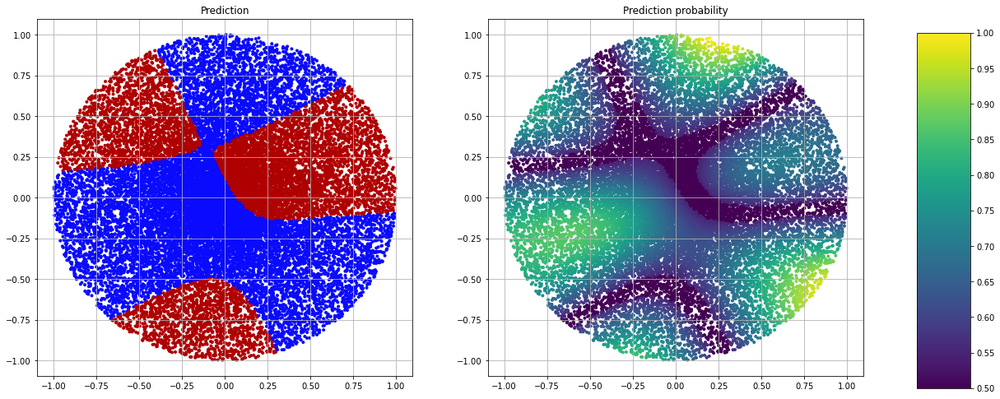

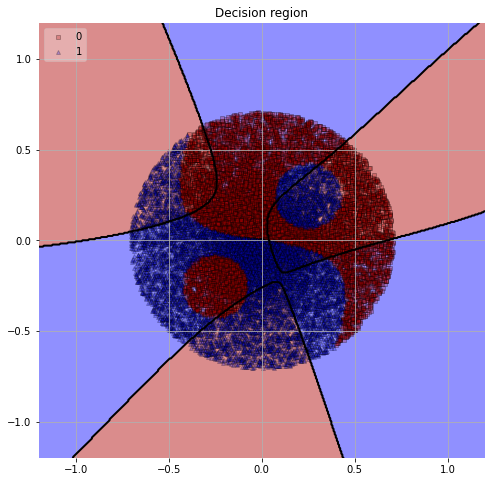

In [18]:
for kernel in ["linear", "poly", "rbf", "sigmoid"]:
    print("="*35, f" {kernel} ", "="*35)
    svc_clf = SVC(kernel=kernel, max_iter=750, random_state=0, probability=True)
    svc_clf.fit(X_train, y_train)

    X_test_augmented = evaluate_and_augment_test(X_test, y_test, svc_clf)
    X_test_augmented['x'] = df.loc[X_test_augmented.index]["x"].copy()
    X_test_augmented['y'] = df.loc[X_test_augmented.index]["y"].copy()
    plot_prediction(X_test_augmented, y_test, svc_clf)

/Users/ajaypethani/anaconda3/lib/python3.7/site-packages/sklearn/neural_network/_multilayer_perceptron.py:617: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


              precision    recall  f1-score   support

           0       0.98      0.99      0.99     12523
           1       0.99      0.98      0.99     12477

    accuracy                           0.99     25000
   macro avg       0.99      0.99      0.99     25000
weighted avg       0.99      0.99      0.99     25000



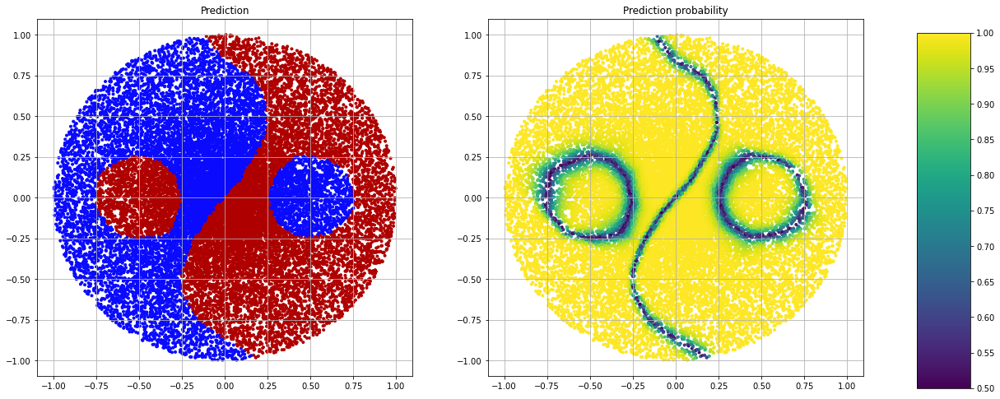

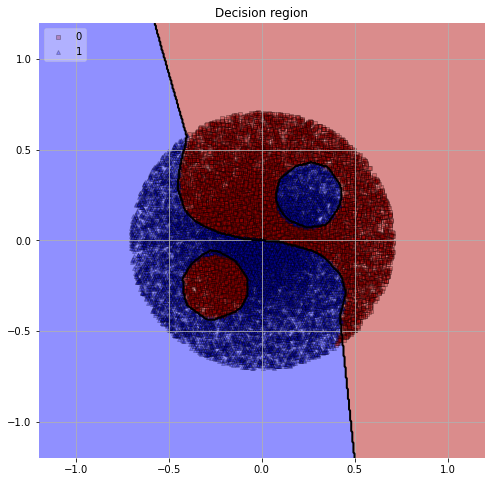

In [19]:
mlp_clf = MLPClassifier(batch_size=1000, random_state=0, max_iter=300)
mlp_clf.fit(X_train, y_train)

X_test_augmented = evaluate_and_augment_test(X_test, y_test, mlp_clf)
X_test_augmented['x'] = df.loc[X_test_augmented.index]["x"].copy()
X_test_augmented['y'] = df.loc[X_test_augmented.index]["y"].copy()
plot_prediction(X_test_augmented, y_test, mlp_clf)

/Users/ajaypethani/anaconda3/lib/python3.7/site-packages/sklearn/neural_network/_multilayer_perceptron.py:617: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


              precision    recall  f1-score   support

           0       0.86      0.87      0.86     12523
           1       0.86      0.85      0.86     12477

    accuracy                           0.86     25000
   macro avg       0.86      0.86      0.86     25000
weighted avg       0.86      0.86      0.86     25000



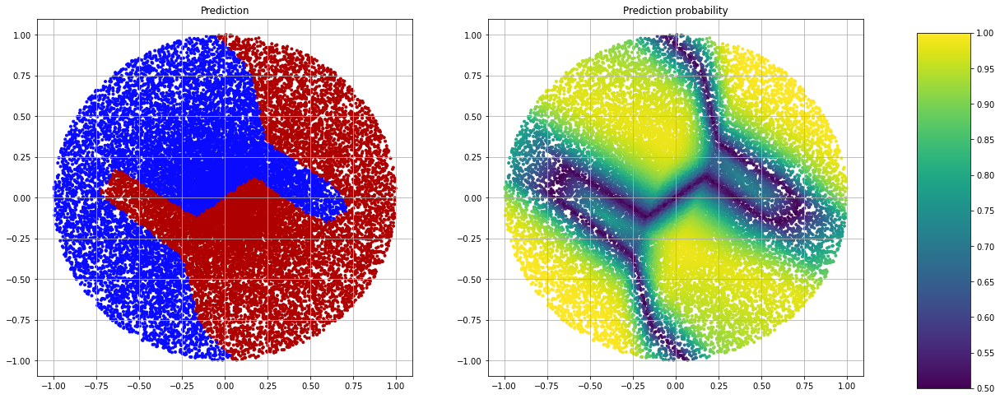

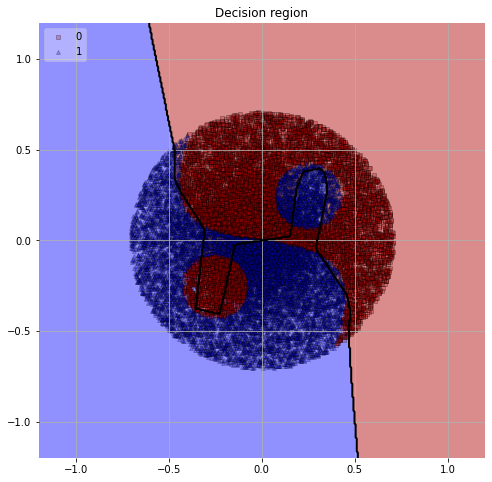

In [20]:
mlp_clf = MLPClassifier(batch_size=10000, random_state=0, max_iter=300)
mlp_clf.fit(X_train, y_train)

X_test_augmented = evaluate_and_augment_test(X_test, y_test, mlp_clf)
X_test_augmented['x'] = df.loc[X_test_augmented.index]["x"].copy()
X_test_augmented['y'] = df.loc[X_test_augmented.index]["y"].copy()
plot_prediction(X_test_augmented, y_test, mlp_clf)

# Using $sin(\pi x)$, $sin(\pi y)$ as inputs

In [21]:
df3 = pd.DataFrame({"feat1": np.sin(np.pi*df.x), "feat2": np.sin(np.pi*df.y), "target": df.target})

In [22]:
X_train, X_test, y_train, y_test = train_test_split(
    df3[["feat1", "feat2"]], df3["target"],
    test_size=0.25, shuffle=False
)

===================================  max_depth=5  ===================================
              precision    recall  f1-score   support

           0       0.88      0.87      0.88     12523
           1       0.87      0.88      0.88     12477

    accuracy                           0.88     25000
   macro avg       0.88      0.88      0.88     25000
weighted avg       0.88      0.88      0.88     25000



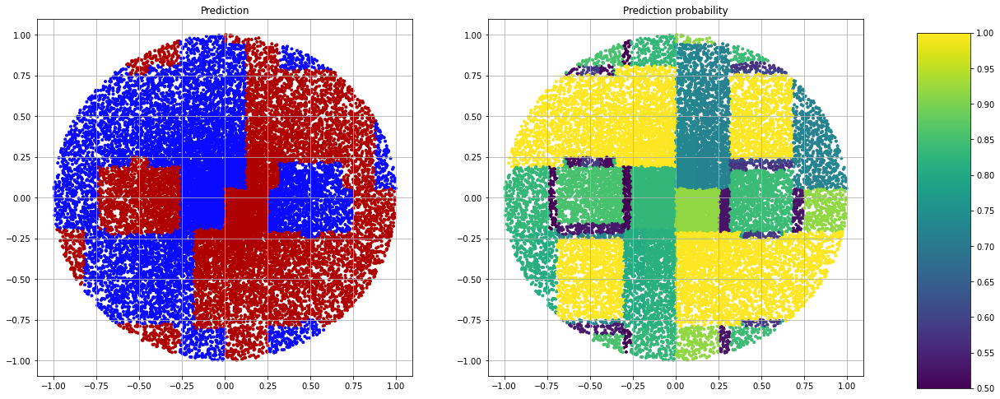

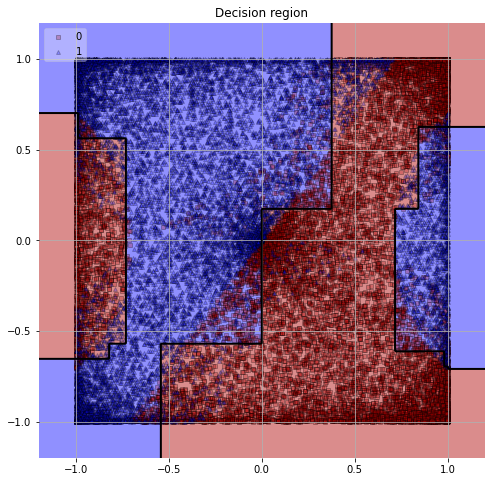

===================================  max_depth=10  ===================================
              precision    recall  f1-score   support

           0       0.93      0.93      0.93     12523
           1       0.93      0.93      0.93     12477

    accuracy                           0.93     25000
   macro avg       0.93      0.93      0.93     25000
weighted avg       0.93      0.93      0.93     25000



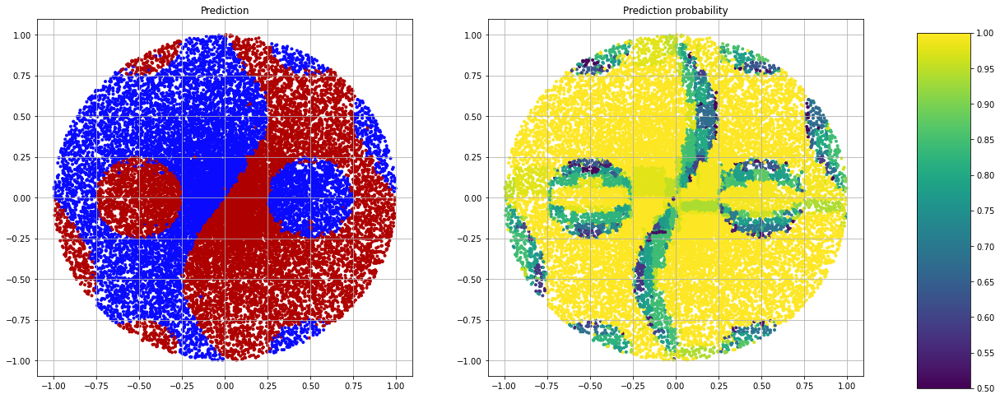

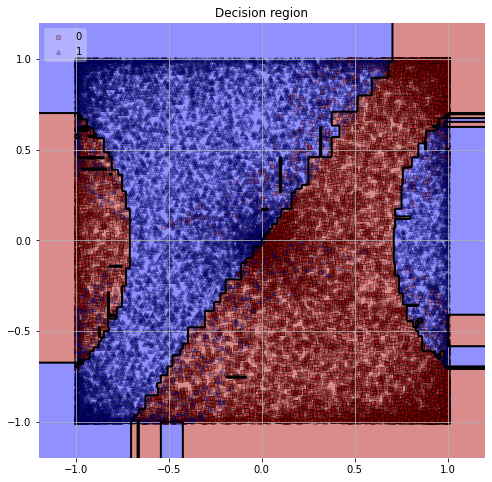

===================================  max_depth=15  ===================================
              precision    recall  f1-score   support

           0       0.93      0.93      0.93     12523
           1       0.93      0.93      0.93     12477

    accuracy                           0.93     25000
   macro avg       0.93      0.93      0.93     25000
weighted avg       0.93      0.93      0.93     25000



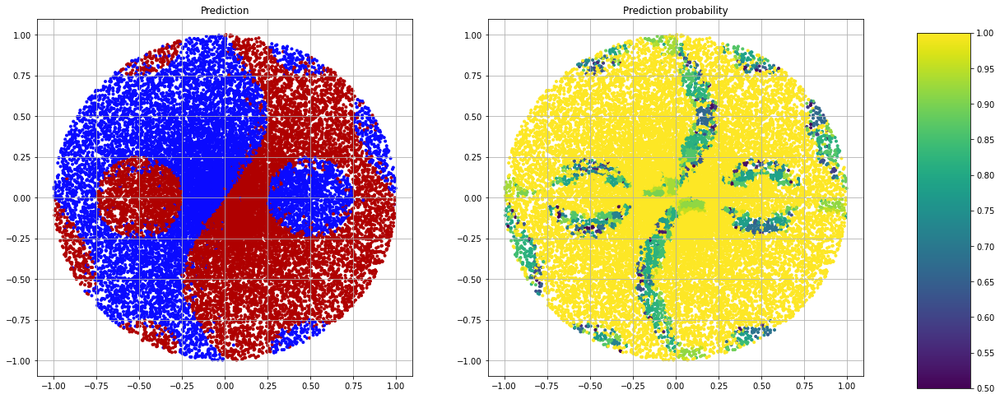

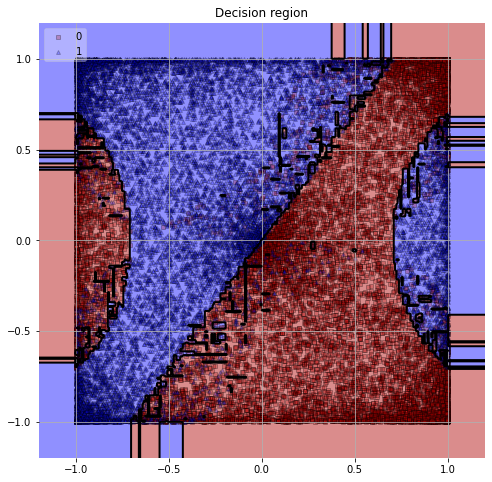

In [23]:
for max_depth in [5, 10, 15]:
    print("="*35, f" max_depth={max_depth} ", "="*35)
    dt_clf = DecisionTreeClassifier(max_depth=max_depth)
    dt_clf.fit(X_train, y_train)

    X_test_augmented = evaluate_and_augment_test(X_test, y_test, dt_clf)
    X_test_augmented['x'] = df.loc[X_test_augmented.index]["x"].copy()
    X_test_augmented['y'] = df.loc[X_test_augmented.index]["y"].copy()
    plot_prediction(X_test_augmented, y_test, dt_clf)

===================================  linear  ===================================


/Users/ajaypethani/anaconda3/lib/python3.7/site-packages/sklearn/svm/_base.py:258: ConvergenceWarning: Solver terminated early (max_iter=750).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


              precision    recall  f1-score   support

           0       0.63      0.61      0.62     12523
           1       0.62      0.63      0.63     12477

    accuracy                           0.62     25000
   macro avg       0.62      0.62      0.62     25000
weighted avg       0.62      0.62      0.62     25000



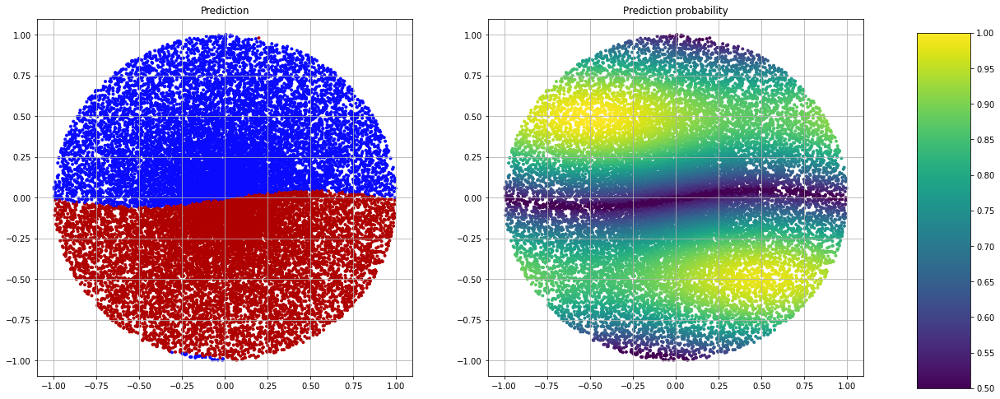

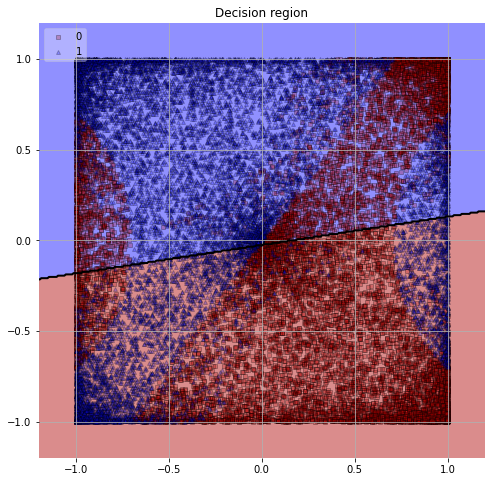

===================================  poly  ===================================


/Users/ajaypethani/anaconda3/lib/python3.7/site-packages/sklearn/svm/_base.py:258: ConvergenceWarning: Solver terminated early (max_iter=750).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


              precision    recall  f1-score   support

           0       0.68      0.28      0.40     12523
           1       0.55      0.87      0.67     12477

    accuracy                           0.57     25000
   macro avg       0.61      0.57      0.53     25000
weighted avg       0.61      0.57      0.53     25000



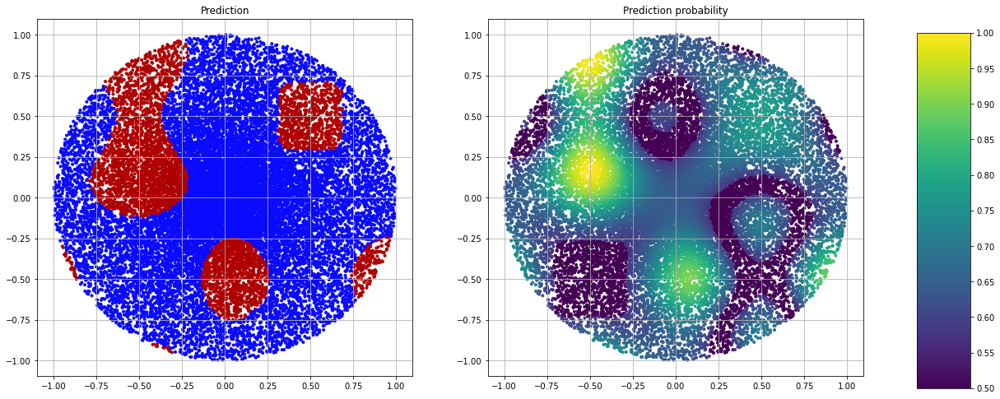

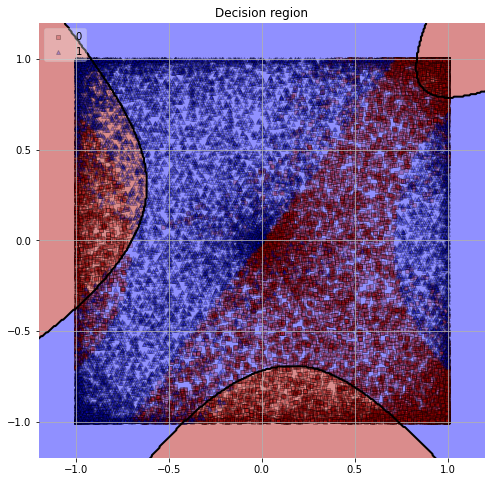

===================================  rbf  ===================================


/Users/ajaypethani/anaconda3/lib/python3.7/site-packages/sklearn/svm/_base.py:258: ConvergenceWarning: Solver terminated early (max_iter=750).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


              precision    recall  f1-score   support

           0       0.69      0.61      0.65     12523
           1       0.65      0.72      0.68     12477

    accuracy                           0.67     25000
   macro avg       0.67      0.67      0.67     25000
weighted avg       0.67      0.67      0.67     25000



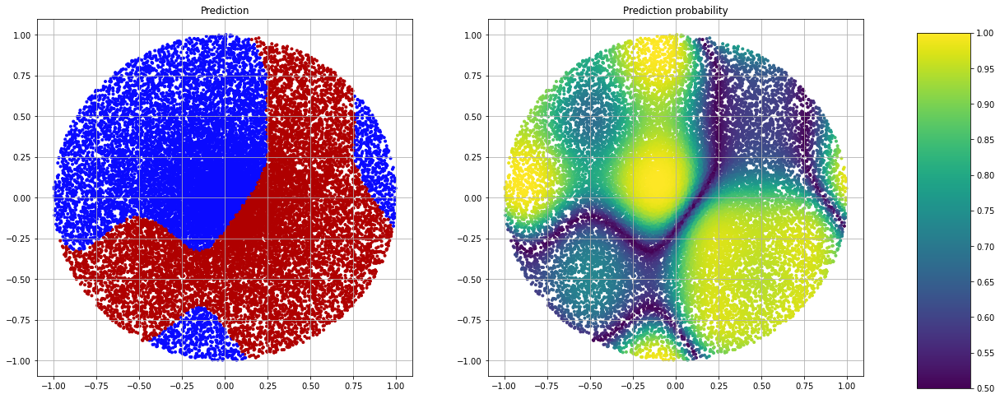

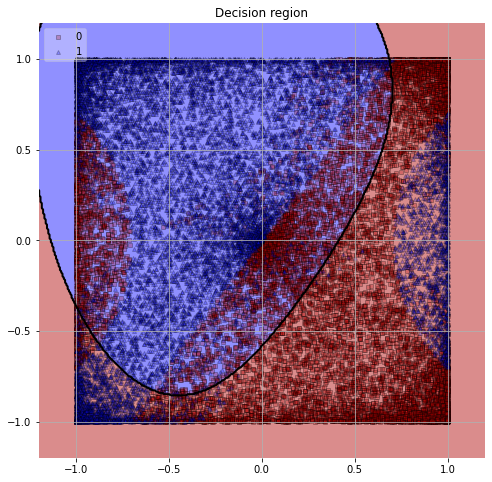

===================================  sigmoid  ===================================


/Users/ajaypethani/anaconda3/lib/python3.7/site-packages/sklearn/svm/_base.py:258: ConvergenceWarning: Solver terminated early (max_iter=750).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


              precision    recall  f1-score   support

           0       0.39      0.36      0.37     12523
           1       0.40      0.44      0.42     12477

    accuracy                           0.40     25000
   macro avg       0.40      0.40      0.40     25000
weighted avg       0.40      0.40      0.40     25000



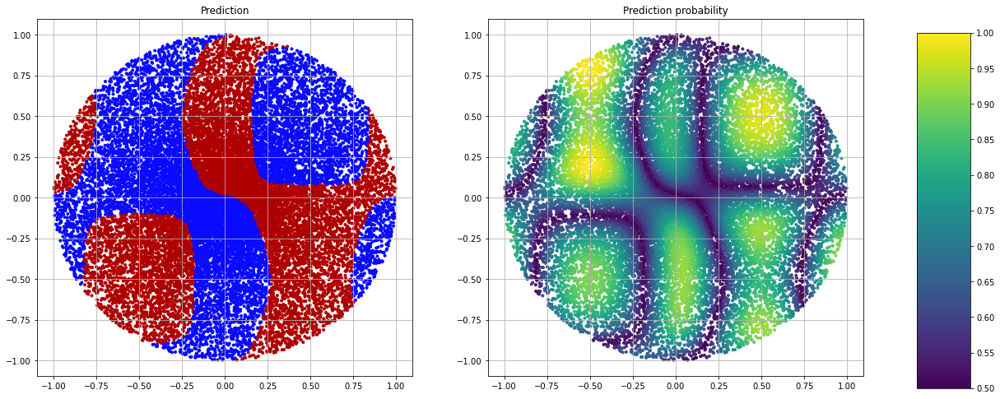

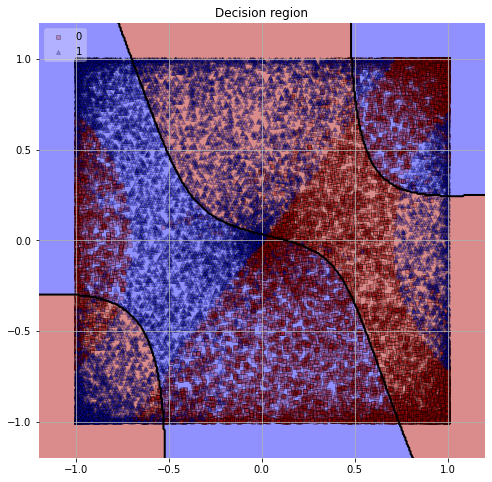

In [24]:
for kernel in ["linear", "poly", "rbf", "sigmoid"]:
    print("="*35, f" {kernel} ", "="*35)
    svc_clf = SVC(kernel=kernel, max_iter=750, random_state=0, probability=True)
    svc_clf.fit(X_train, y_train)

    X_test_augmented = evaluate_and_augment_test(X_test, y_test, svc_clf)
    X_test_augmented['x'] = df.loc[X_test_augmented.index]["x"].copy()
    X_test_augmented['y'] = df.loc[X_test_augmented.index]["y"].copy()
    plot_prediction(X_test_augmented, y_test, svc_clf)

              precision    recall  f1-score   support

           0       0.92      0.92      0.92     12523
           1       0.92      0.92      0.92     12477

    accuracy                           0.92     25000
   macro avg       0.92      0.92      0.92     25000
weighted avg       0.92      0.92      0.92     25000



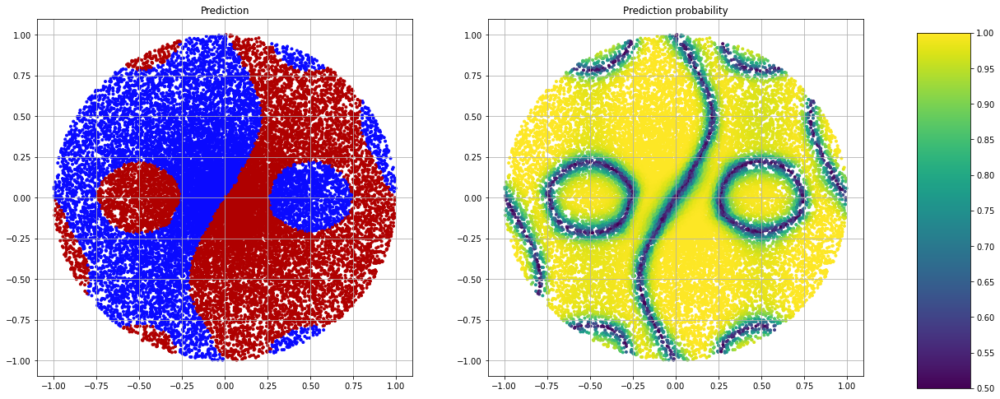

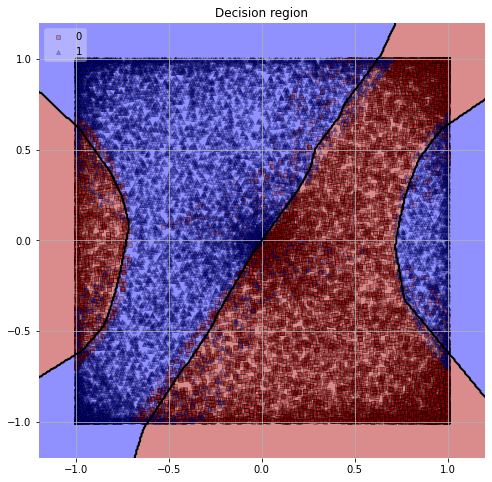

In [25]:
mlp_clf = MLPClassifier(batch_size=1000, random_state=0, max_iter=300)
mlp_clf.fit(X_train, y_train)

X_test_augmented = evaluate_and_augment_test(X_test, y_test, mlp_clf)
X_test_augmented['x'] = df.loc[X_test_augmented.index]["x"].copy()
X_test_augmented['y'] = df.loc[X_test_augmented.index]["y"].copy()
plot_prediction(X_test_augmented, y_test, mlp_clf)

/Users/ajaypethani/anaconda3/lib/python3.7/site-packages/sklearn/neural_network/_multilayer_perceptron.py:617: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


              precision    recall  f1-score   support

           0       0.92      0.92      0.92     12523
           1       0.92      0.91      0.92     12477

    accuracy                           0.92     25000
   macro avg       0.92      0.92      0.92     25000
weighted avg       0.92      0.92      0.92     25000



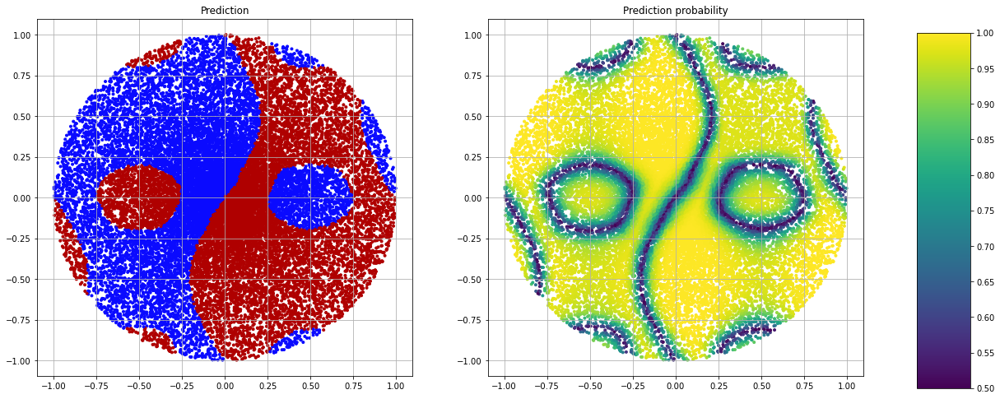

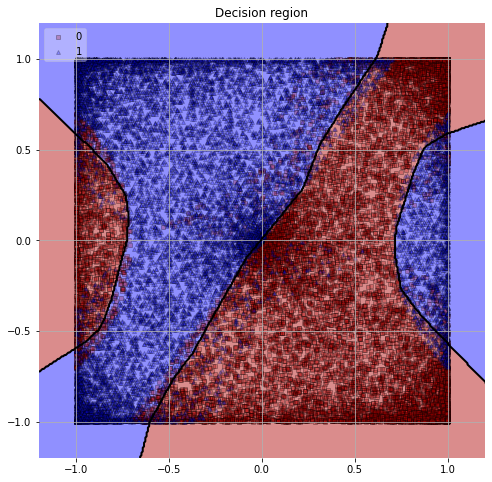

In [26]:
mlp_clf = MLPClassifier(batch_size=10000, random_state=0, max_iter=300)
mlp_clf.fit(X_train, y_train)

X_test_augmented = evaluate_and_augment_test(X_test, y_test, mlp_clf)
X_test_augmented['x'] = df.loc[X_test_augmented.index]["x"].copy()
X_test_augmented['y'] = df.loc[X_test_augmented.index]["y"].copy()
plot_prediction(X_test_augmented, y_test, mlp_clf)

              precision    recall  f1-score   support

           0       0.93      0.93      0.93     12523
           1       0.93      0.93      0.93     12477

    accuracy                           0.93     25000
   macro avg       0.93      0.93      0.93     25000
weighted avg       0.93      0.93      0.93     25000



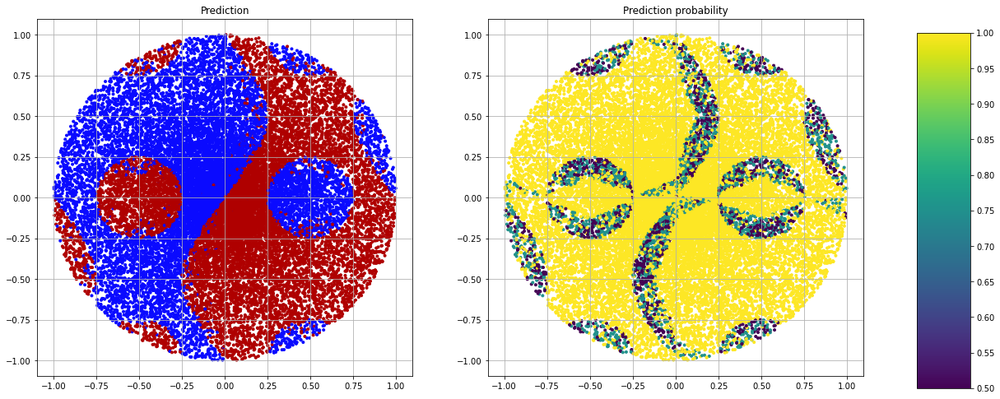

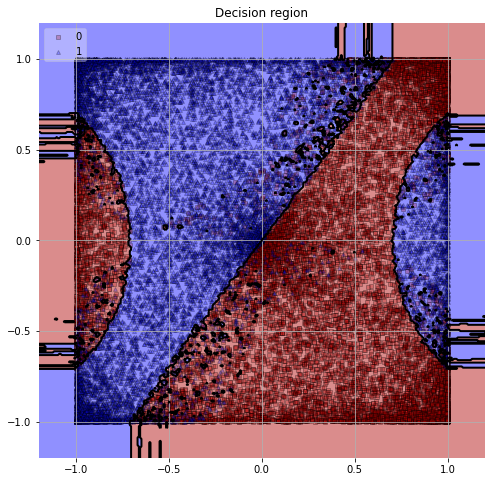

In [27]:
knn_clf = KNeighborsClassifier()
knn_clf.fit(X_train, y_train)

X_test_augmented = evaluate_and_augment_test(X_test, y_test, knn_clf)
X_test_augmented['x'] = df.loc[X_test_augmented.index]["x"].copy()
X_test_augmented['y'] = df.loc[X_test_augmented.index]["y"].copy()
plot_prediction(X_test_augmented, y_test, knn_clf)

# Using $sin(\pi (x + y)/2)$, $sin(\pi (x - y)/2)$ as inputs

In [28]:
df4 = pd.DataFrame({"feat1": np.sin(np.pi*(df.x + df.y)/2), "feat2": np.sin(np.pi*(df.x - df.y)/2), "target": df.target})

In [29]:
X_train, X_test, y_train, y_test = train_test_split(
    df4[["feat1", "feat2"]], df4["target"],
    test_size=0.25, shuffle=False
)

===================================  max_depth=5  ===================================
              precision    recall  f1-score   support

           0       0.87      0.87      0.87     12523
           1       0.87      0.86      0.87     12477

    accuracy                           0.87     25000
   macro avg       0.87      0.87      0.87     25000
weighted avg       0.87      0.87      0.87     25000



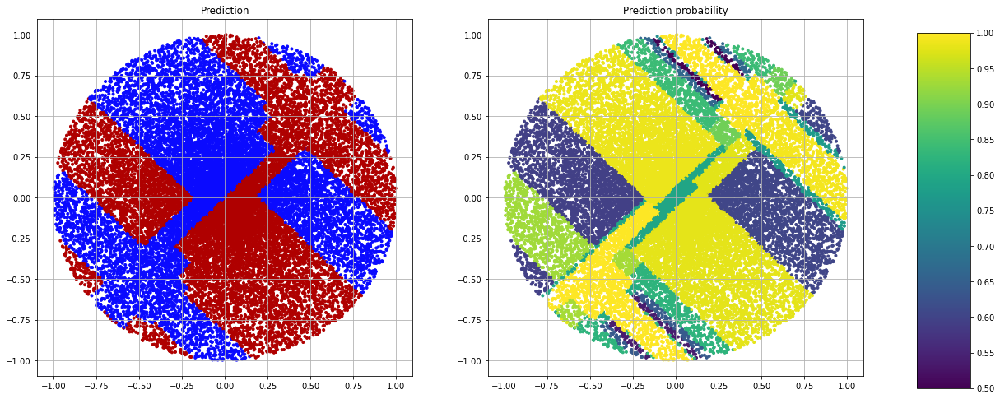

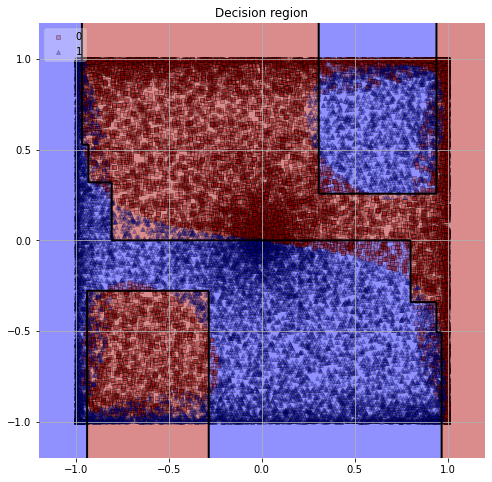

===================================  max_depth=10  ===================================
              precision    recall  f1-score   support

           0       0.95      0.94      0.94     12523
           1       0.94      0.95      0.94     12477

    accuracy                           0.94     25000
   macro avg       0.94      0.94      0.94     25000
weighted avg       0.94      0.94      0.94     25000



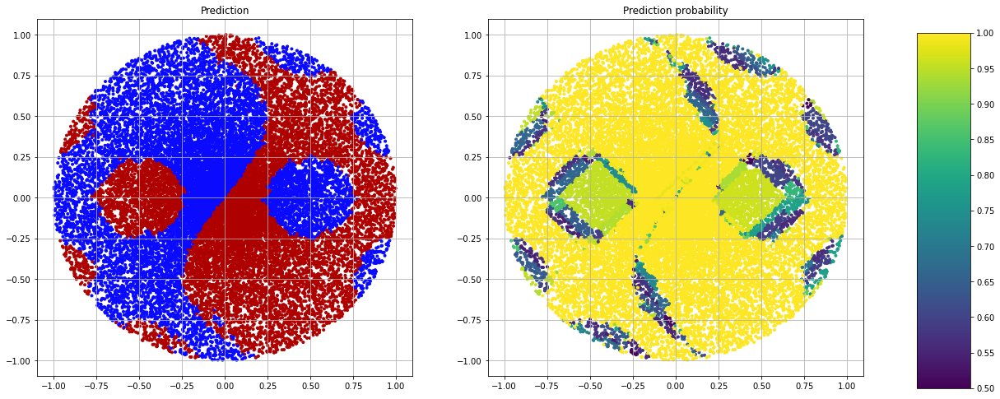

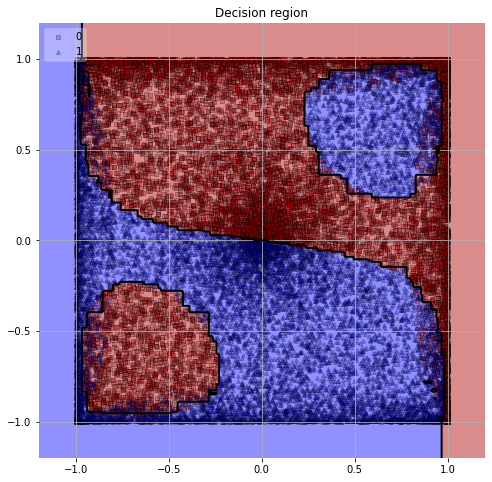

===================================  max_depth=15  ===================================
              precision    recall  f1-score   support

           0       0.95      0.94      0.94     12523
           1       0.94      0.95      0.94     12477

    accuracy                           0.94     25000
   macro avg       0.94      0.94      0.94     25000
weighted avg       0.94      0.94      0.94     25000



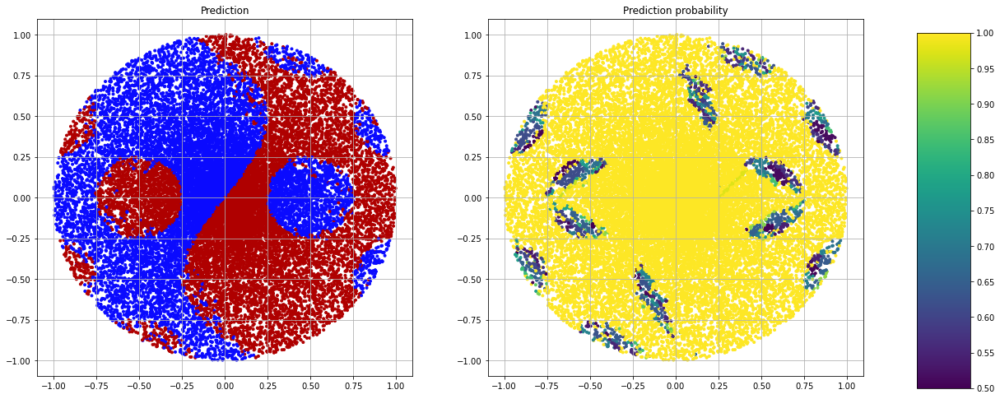

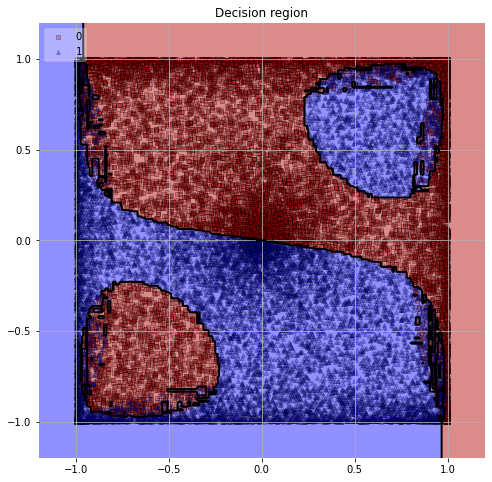

In [30]:
for max_depth in [5, 10, 15]:
    print("="*35, f" max_depth={max_depth} ", "="*35)
    dt_clf = DecisionTreeClassifier(max_depth=max_depth)
    dt_clf.fit(X_train, y_train)

    X_test_augmented = evaluate_and_augment_test(X_test, y_test, dt_clf)
    X_test_augmented['x'] = df.loc[X_test_augmented.index]["x"].copy()
    X_test_augmented['y'] = df.loc[X_test_augmented.index]["y"].copy()
    plot_prediction(X_test_augmented, y_test, dt_clf)

===================================  linear  ===================================


/Users/ajaypethani/anaconda3/lib/python3.7/site-packages/sklearn/svm/_base.py:258: ConvergenceWarning: Solver terminated early (max_iter=750).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


              precision    recall  f1-score   support

           0       0.50      0.47      0.48     12523
           1       0.49      0.52      0.51     12477

    accuracy                           0.50     25000
   macro avg       0.50      0.50      0.50     25000
weighted avg       0.50      0.50      0.50     25000



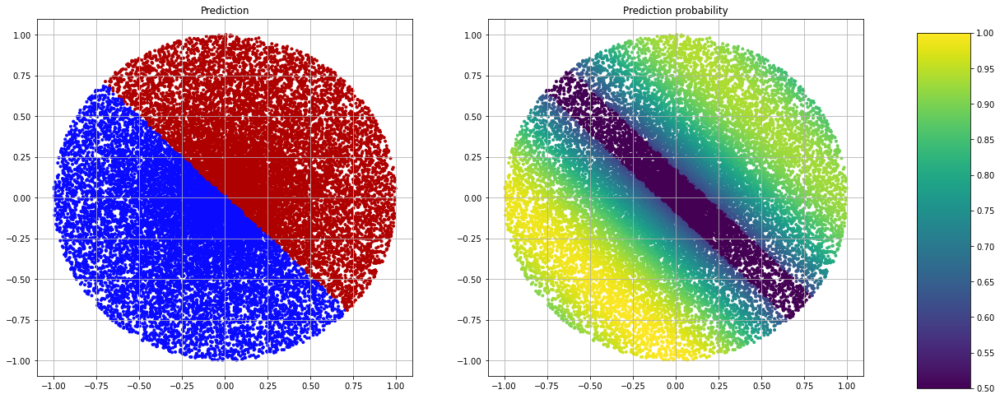

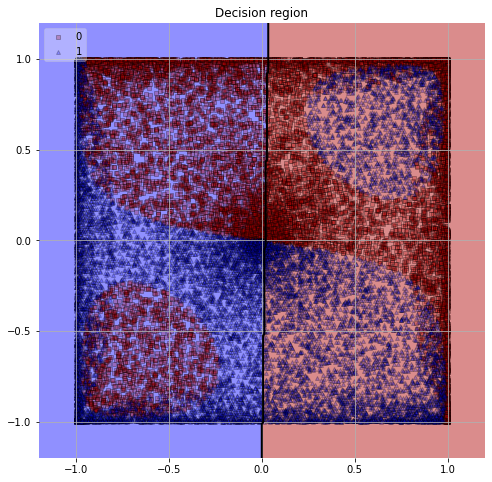

===================================  poly  ===================================


/Users/ajaypethani/anaconda3/lib/python3.7/site-packages/sklearn/svm/_base.py:258: ConvergenceWarning: Solver terminated early (max_iter=750).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


              precision    recall  f1-score   support

           0       0.34      0.25      0.29     12523
           1       0.41      0.52      0.46     12477

    accuracy                           0.39     25000
   macro avg       0.38      0.39      0.37     25000
weighted avg       0.38      0.39      0.37     25000



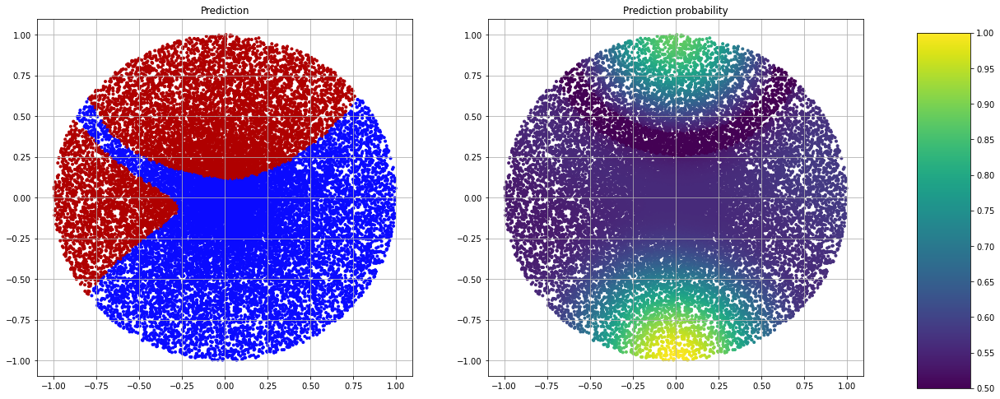

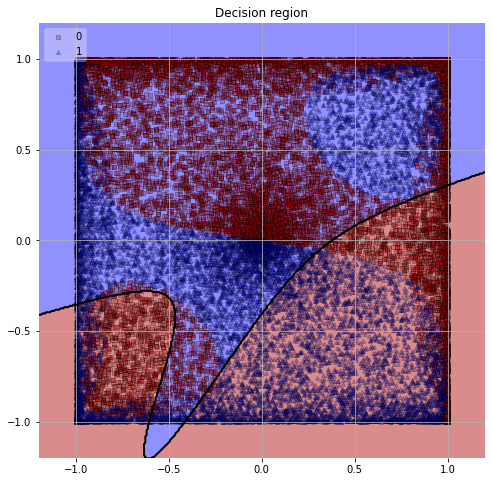

===================================  rbf  ===================================


/Users/ajaypethani/anaconda3/lib/python3.7/site-packages/sklearn/svm/_base.py:258: ConvergenceWarning: Solver terminated early (max_iter=750).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


              precision    recall  f1-score   support

           0       0.61      0.63      0.62     12523
           1       0.62      0.60      0.61     12477

    accuracy                           0.61     25000
   macro avg       0.61      0.61      0.61     25000
weighted avg       0.61      0.61      0.61     25000



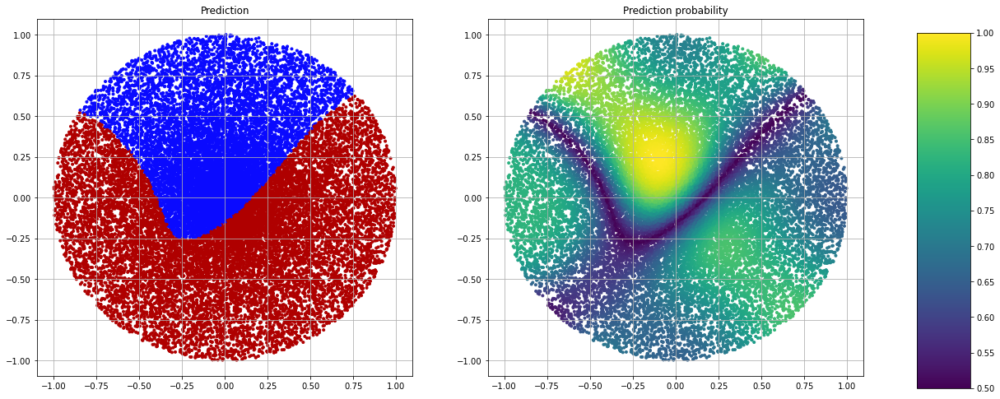

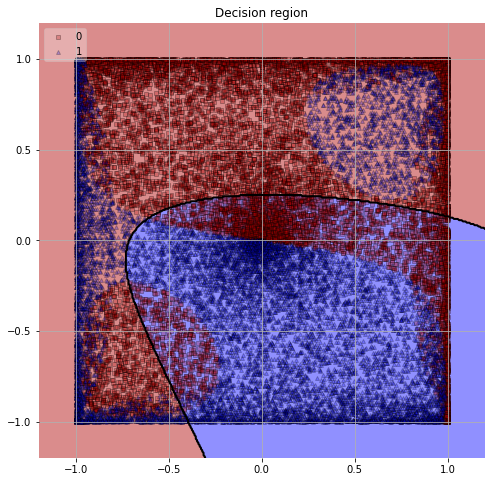

===================================  sigmoid  ===================================


/Users/ajaypethani/anaconda3/lib/python3.7/site-packages/sklearn/svm/_base.py:258: ConvergenceWarning: Solver terminated early (max_iter=750).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


              precision    recall  f1-score   support

           0       0.36      0.31      0.33     12523
           1       0.40      0.46      0.43     12477

    accuracy                           0.38     25000
   macro avg       0.38      0.38      0.38     25000
weighted avg       0.38      0.38      0.38     25000



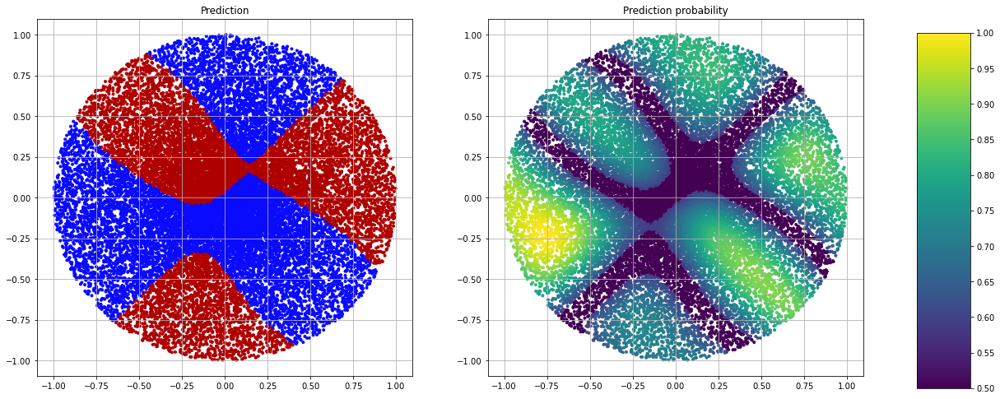

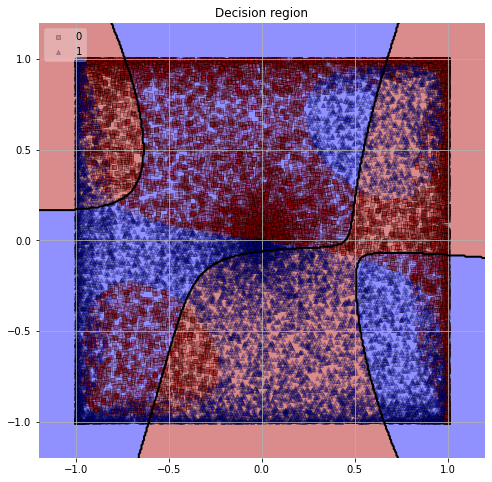

In [31]:
for kernel in ["linear", "poly", "rbf", "sigmoid"]:
    print("="*35, f" {kernel} ", "="*35)
    svc_clf = SVC(kernel=kernel, max_iter=750, random_state=0, probability=True)
    svc_clf.fit(X_train, y_train)

    X_test_augmented = evaluate_and_augment_test(X_test, y_test, svc_clf)
    X_test_augmented['x'] = df.loc[X_test_augmented.index]["x"].copy()
    X_test_augmented['y'] = df.loc[X_test_augmented.index]["y"].copy()
    plot_prediction(X_test_augmented, y_test, svc_clf)

/Users/ajaypethani/anaconda3/lib/python3.7/site-packages/sklearn/neural_network/_multilayer_perceptron.py:617: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


              precision    recall  f1-score   support

           0       0.94      0.94      0.94     12523
           1       0.94      0.94      0.94     12477

    accuracy                           0.94     25000
   macro avg       0.94      0.94      0.94     25000
weighted avg       0.94      0.94      0.94     25000



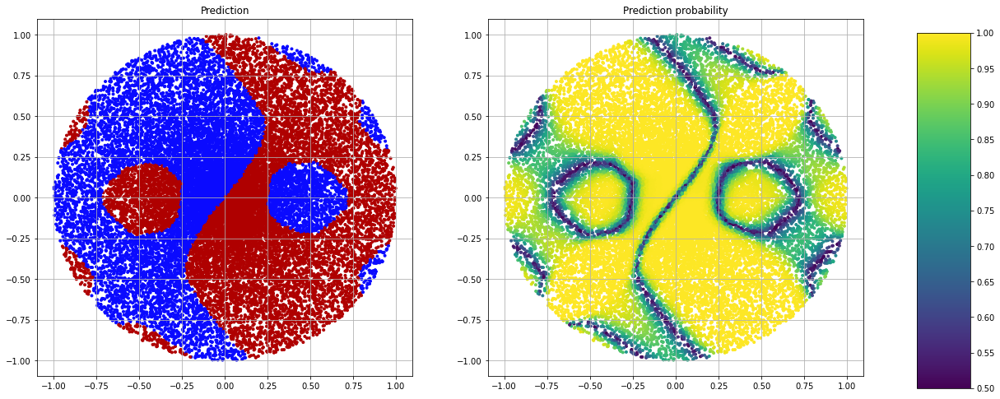

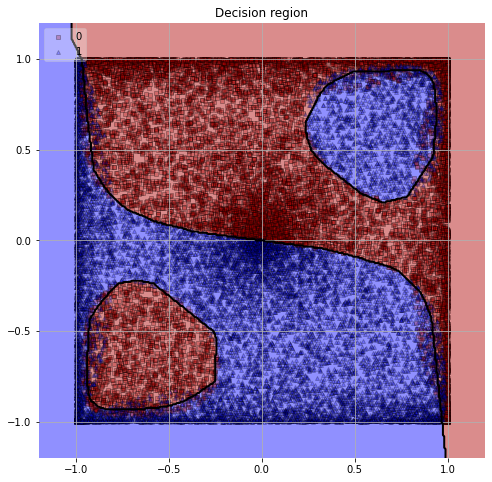

In [32]:
mlp_clf = MLPClassifier(batch_size=1000, random_state=0, max_iter=300)
mlp_clf.fit(X_train, y_train)

X_test_augmented = evaluate_and_augment_test(X_test, y_test, mlp_clf)
X_test_augmented['x'] = df.loc[X_test_augmented.index]["x"].copy()
X_test_augmented['y'] = df.loc[X_test_augmented.index]["y"].copy()
plot_prediction(X_test_augmented, y_test, mlp_clf)

/Users/ajaypethani/anaconda3/lib/python3.7/site-packages/sklearn/neural_network/_multilayer_perceptron.py:617: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


              precision    recall  f1-score   support

           0       0.87      0.88      0.88     12523
           1       0.88      0.87      0.88     12477

    accuracy                           0.88     25000
   macro avg       0.88      0.88      0.88     25000
weighted avg       0.88      0.88      0.88     25000



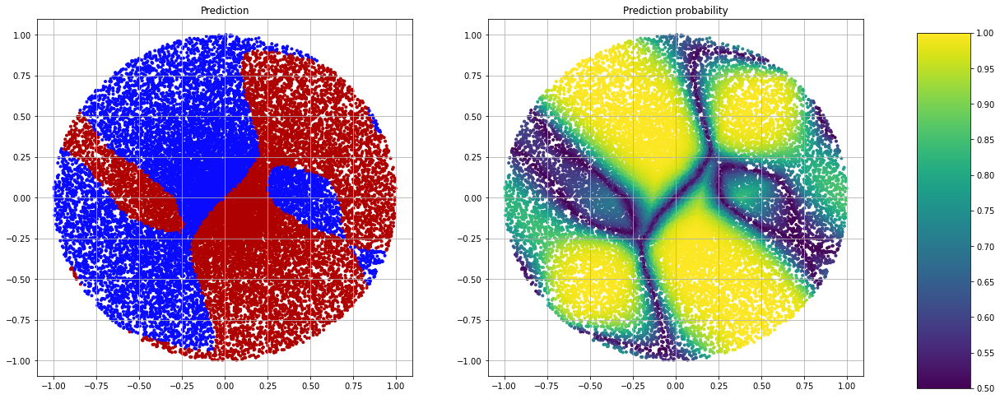

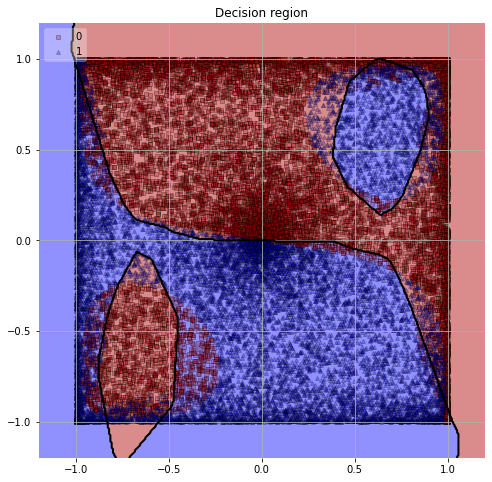

In [33]:
mlp_clf = MLPClassifier(batch_size=10000, random_state=0, max_iter=300)
mlp_clf.fit(X_train, y_train)

X_test_augmented = evaluate_and_augment_test(X_test, y_test, mlp_clf)
X_test_augmented['x'] = df.loc[X_test_augmented.index]["x"].copy()
X_test_augmented['y'] = df.loc[X_test_augmented.index]["y"].copy()
plot_prediction(X_test_augmented, y_test, mlp_clf)

              precision    recall  f1-score   support

           0       0.95      0.94      0.94     12523
           1       0.94      0.95      0.94     12477

    accuracy                           0.94     25000
   macro avg       0.94      0.94      0.94     25000
weighted avg       0.94      0.94      0.94     25000



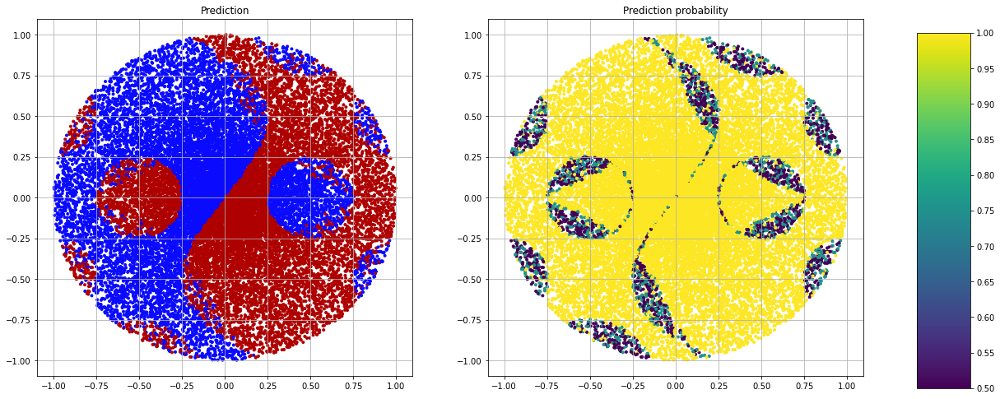

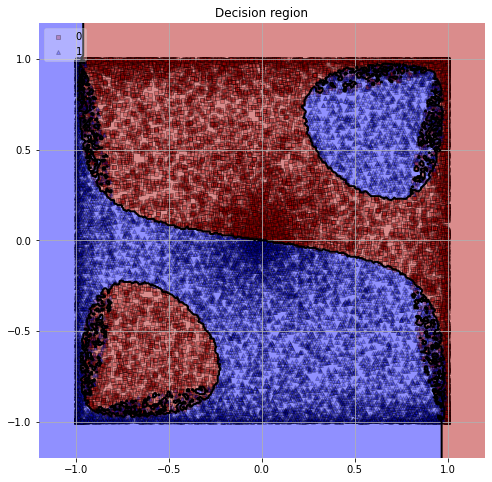

In [34]:
knn_clf = KNeighborsClassifier()
knn_clf.fit(X_train, y_train)

X_test_augmented = evaluate_and_augment_test(X_test, y_test, knn_clf)
X_test_augmented['x'] = df.loc[X_test_augmented.index]["x"].copy()
X_test_augmented['y'] = df.loc[X_test_augmented.index]["y"].copy()
plot_prediction(X_test_augmented, y_test, knn_clf)